In [1]:
!pip install -q underthesea

# Import Lib

In [2]:
import json
import os
import pandas as pd
import numpy as np
import re
import string
import pickle
import torch.nn as nn
from underthesea import word_tokenize, text_normalize
import random
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import spacy
from collections import Counter
from tqdm import tqdm
from torch.utils.data import Dataset, DataLoader
import torch
import torchvision.models as models
from torchvision.models import resnet50, ResNet50_Weights
import torch.nn.functional as F
import math
import torch.optim as optim
import time
from torch.optim import AdamW
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from transformers import AutoModel, CLIPImageProcessor, AutoTokenizer, AutoImageProcessor, ViTModel

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
TRAIN_BATCH_SIZE = 16
VAL_BATCH_SIZE = 1
MAX_LEN = 40
EPOCHS = 7

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# Import file

In [3]:
def read_json(path):
    with open(path, 'r') as f:
        data = json.load(f)
        images_list = data['annotations']
        return pd.DataFrame(images_list)

In [4]:
df_train = read_json("/kaggle/input/vitextvqa/ViTextVQA_json/ViTextVQA_train.json")
df_test = read_json("/kaggle/input/testdataset-cv/data_test_cv/My_ViTextVQA_test.json")
df_val = read_json("/kaggle/input/vitextvqa/ViTextVQA_json/ViTextVQA_dev.json")
# df_train = df_train.iloc[0:10]
df_test

,id,image_id,question,answers
0,a1,IMG_0,số điện thoại của cửa hàng là bao nhiêu ?,[0562 000 100]
1,a2,IMG_0,địa chỉ website của của hàng là gì ?,[burgerpapa . com]
2,a3,IMG_0,tên cửa hàng là gì ?,[burger papa]
3,a4,IMG_0,tên cửa hàng bán món gì ?,[burger - gà rán - taco]
4,a5,IMG_1,tên của cửa tiệm này là gì ?,[bánh mì pewpew]
...,...,...,...,...
95,a94,IMG_45,dặc điểm của loài động vật trên bảng là gì ?,"[hình dạng giống kỳ đà , thường có màu xanh . ..."
96,a95,IMG_47,đây là hội nghị gì ?,[khoa học cấp khoa]
97,a96,IMG_47,hội nghị này tổ chức ai ?,"[khoa công nghệ thông tin , đại học công nghiệ..."
98,a97,IMG_47,hội nghị này tổ chức vào thời gian nào ?,[15 tháng 12 năm 2024]


# Processing data

In [5]:
def format_image(root_dir, df_1):
    df_1["path"] = df_1['image_id'].apply(lambda x: os.path.join(root_dir, str(x) + ".jpg"))
    df_1 = df_1.dropna(subset=['question','answers']).copy()
    df_1['question'] = df_1['question'].astype(str)
    df_1['answers'] = df_1['answers'].astype(str)
    # df_1 = df_1.drop(["id"], axis = 1)
    df_1.reset_index(drop=True, inplace=True)
    new_columns = ["id",'image_id', "path", 'question', 'answers']
    df_1 = df_1[new_columns]
    return df_1

In [6]:
root_dir = '/kaggle/input/vitextvqa/ViTextVQA_images/st_images'
root_dir_2 = '/kaggle/input/testdataset-cv/data_test_cv/image'
df_train = format_image(root_dir, df_train)
df_test = format_image(root_dir_2, df_test)
df_val = format_image(root_dir, df_val)
df_test

,id,image_id,path,question,answers
0,a1,IMG_0,/kaggle/input/testdataset-cv/data_test_cv/imag...,số điện thoại của cửa hàng là bao nhiêu ?,['0562 000 100']
1,a2,IMG_0,/kaggle/input/testdataset-cv/data_test_cv/imag...,địa chỉ website của của hàng là gì ?,['burgerpapa . com']
2,a3,IMG_0,/kaggle/input/testdataset-cv/data_test_cv/imag...,tên cửa hàng là gì ?,['burger papa']
3,a4,IMG_0,/kaggle/input/testdataset-cv/data_test_cv/imag...,tên cửa hàng bán món gì ?,['burger - gà rán - taco']
4,a5,IMG_1,/kaggle/input/testdataset-cv/data_test_cv/imag...,tên của cửa tiệm này là gì ?,['bánh mì pewpew']
...,...,...,...,...,...
95,a94,IMG_45,/kaggle/input/testdataset-cv/data_test_cv/imag...,dặc điểm của loài động vật trên bảng là gì ?,"['hình dạng giống kỳ đà , thường có màu xanh ...."
96,a95,IMG_47,/kaggle/input/testdataset-cv/data_test_cv/imag...,đây là hội nghị gì ?,['khoa học cấp khoa']
97,a96,IMG_47,/kaggle/input/testdataset-cv/data_test_cv/imag...,hội nghị này tổ chức ai ?,"['khoa công nghệ thông tin , đại học công nghi..."
98,a97,IMG_47,/kaggle/input/testdataset-cv/data_test_cv/imag...,hội nghị này tổ chức vào thời gian nào ?,['15 tháng 12 năm 2024']


In [7]:
def normalize_text(text):
    clean_text = text.lower()

    replacements = {
        "[": "",
        "]": ""
    }

    for old, new in replacements.items():
        clean_text = clean_text.replace(old, new)

    # Xóa ký tự đặc biệt VD (&nbsp;)
    clean_text = re.sub(r'&\S+;', ' ', clean_text)

    # Xóa emoji
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F"
                               u"\U0001F300-\U0001F5FF"
                               u"\U0001F680-\U0001F6FF"
                               u"\U0001F1E0-\U0001F1FF"
                               u"\U00002702-\U000027B0"
                               u"\U000024C2-\U0001F251"
                               u"\U0001f926-\U0001f937"
                               u'\U00010000-\U0010ffff'
                               u"\u200d"
                               u"\u2640-\u2642"
                               u"\u2600-\u2B55"
                               u"\u23cf"
                               u"\u23e9"
                               u"\u231a"
                               u"\u3030"
                               u"\ufe0f"
                               "]+", flags=re.UNICODE)
    clean_text = re.sub(emoji_pattern, " ", clean_text)

    # Xóa ký tự đặc biệt không gõ được
    special_chars = ["“", "”", "…", "•", "–", "’", " ️", "✅", "✓", " ̂́ ̃ ̣̂ ", "‘", "●", "‒", "➤",
                     "★", "ღ", "✪", "‎", "➦", "×", "", "✿", "☆", "◤", "◕", "❁", "‿",
                     "❀", "■", "█", "☛", "⑴⒪⑵⑵⑴⑺", "►", "°", "»", "ø", "➽", "", "✧", "✽", "*",
                     "➫", "【", "】", "⇒", "卐", "♛", "±", "∞", "②", "⑥", "①", "⑦", "➋", "➊", "➌",
                     "✓", "™", "®", "", "'"]
    for char in special_chars:
        clean_text = clean_text.replace(char, " ")

    # # Bỏ các ký tự đặc biệt (dấu câu)
    # clean_text = ''.join(' ' if char in string.punctuation else char for char in clean_text)

    # Loại bỏ khoảng trắng thừa
    clean_text = re.sub(r"\s+", " ", clean_text)
    clean_text = re.sub(r"^[\s]", "", clean_text)
    clean_text = re.sub(r"[\s]$", "", clean_text)

    # Đảm bảo dấu ở đúng chữ (ví dụ: oà, uý)
    clean_text = text_normalize(clean_text)

    # Tách câu thành từ
    clean_text = word_tokenize(clean_text, format="text")

    return clean_text

def apply_normalize_text_to_dataframe(df, columns):
    for col in columns:
        df[col] = df[col].apply(lambda x: normalize_text(str(x)))
    return df

In [8]:
columns_to_process = ['question', 'answers']
df_train = apply_normalize_text_to_dataframe(df_train, columns_to_process)
df_test = apply_normalize_text_to_dataframe(df_test, columns_to_process)
df_val = apply_normalize_text_to_dataframe(df_val, columns_to_process)
df_train

,id,image_id,path,question,answers
0,1,0,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,quán ăn này bán những món gì ?,"mì quảng , bún_bò huế"
1,2,0,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,quán ăn này bán mì gì ?,mì quảng
2,3,0,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,quán ăn gì bán bún gì ?,bún bò huế
3,4,0,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,quán ăn này địa_chỉ ở đâu ?,"13 a_trần quốc_thảo , phường 7 , quận 3"
4,5,1,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,tiệm trong ảnh là tiệm gì ?,sửa xe
...,...,...,...,...,...
35154,50338,16760,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,cuốn sách này có tên là gì ?,phố cổ hà_nội kí_họa và hồi_ức
35155,50339,16760,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,dòng chữ ở góc trên bên phải cuốn sách này là ...,nhiều tác_giả
35156,50340,16761,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,bệnh_viện này có tên là gì ?,bệnh nhiệt_đới trung_ương
35157,50341,16761,/kaggle/input/vitextvqa/ViTextVQA_images/st_im...,bệnh_viện này thuộc bộ nào ?,y_tế


# Data visualization

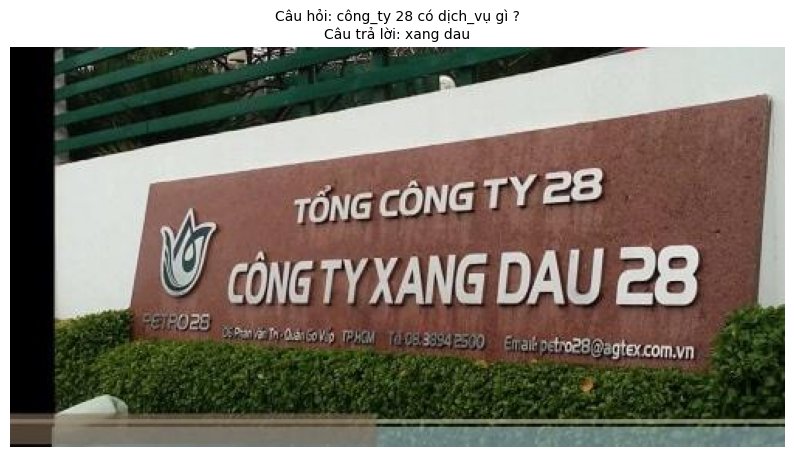

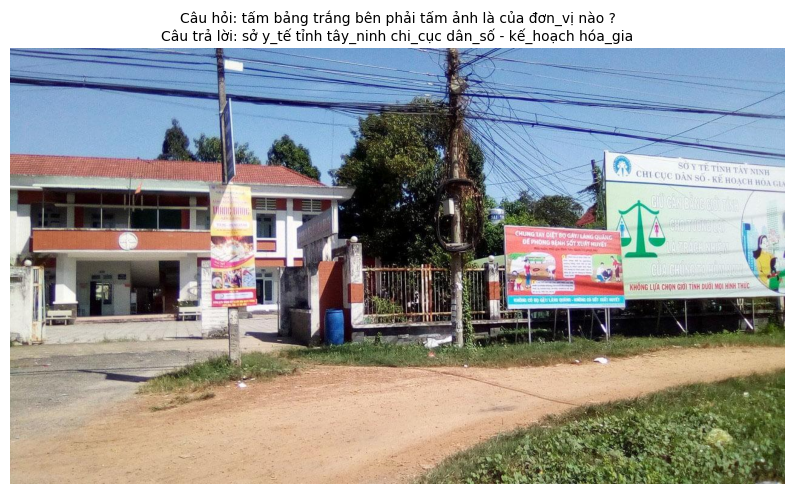

In [9]:
samples = df_train.sample(n=random.randint(2, min(2, len(df_train)))).reset_index(drop=True)

for i, row in samples.iterrows():
    image = row['path']
    question = row['question']
    answer = row['answers']

    try:
        # Mở và hiển thị hình ảnh
        img = Image.open(image)

        plt.figure(figsize=(10, 10))
        plt.imshow(img)
        plt.title(f"Câu hỏi: {question}\nCâu trả lời: {answer}", fontsize=10)
        plt.axis('off')  # Ẩn trục để hiển thị gọn gàng hơn
        plt.show()
    except FileNotFoundError:
        print(f"Không tìm thấy hình ảnh: {image}")
    except Exception as e:
        print(f"Lỗi khi tải hình ảnh {image}: {e}")

In [10]:
def get_sentence_length(text):
    if not isinstance(text, str):
        return 0
    tokens = word_tokenize(text)
    return len(tokens)

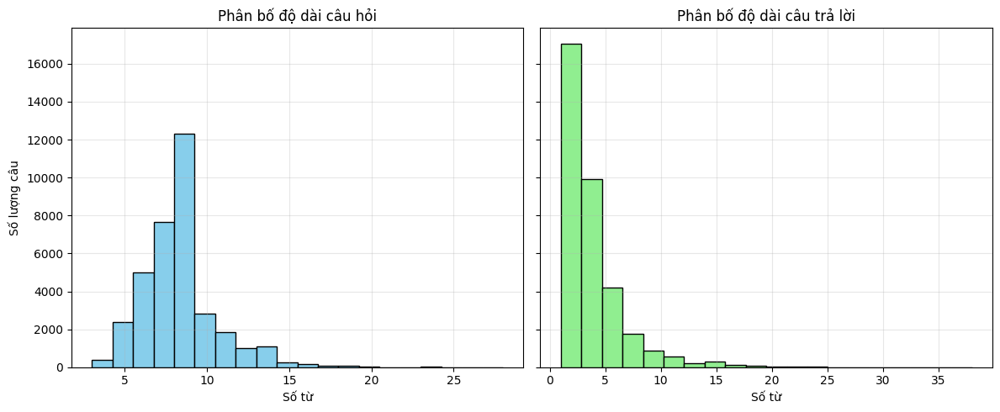

In [11]:
question_lengths = df_train['question'].apply(get_sentence_length).tolist()
answer_lengths = df_train['answers'].apply(get_sentence_length).tolist()

# Thiết lập bố cục subplot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5), sharey=True)

# Biểu đồ 1: Độ dài câu hỏi
ax1.hist(question_lengths, bins=20, color='skyblue', edgecolor='black')
ax1.set_title('Phân bố độ dài câu hỏi')
ax1.set_xlabel('Số từ')
ax1.set_ylabel('Số lượng câu')
ax1.grid(True, alpha=0.3)

# Biểu đồ 2: Độ dài câu trả lời
ax2.hist(answer_lengths, bins=20, color='lightgreen', edgecolor='black')
ax2.set_title('Phân bố độ dài câu trả lời')
ax2.set_xlabel('Số từ')
ax2.grid(True, alpha=0.3)

# Tùy chỉnh khoảng cách giữa các subplot
plt.tight_layout()

# Tokenize

In [12]:
tokenizer = AutoTokenizer.from_pretrained("vinai/phobert-base")
vocab = tokenizer.get_vocab()
len(vocab)

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


64001

# Change form to dataset

In [13]:
class VLSP_Dataset(Dataset):
    def __init__(self, dataframe, transform=None):
        self.data = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        anno_id, img_id, image_path, question, answer = self.data.iloc[idx]
        image = Image.open(image_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        return anno_id, img_id, image, question, answer

In [14]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),

    # #Thêm 1 vài bước xử lý ảnh để đa dạng hóa dữ liệu - Data Augmentation
    transforms.RandomRotation(30),  # Xoay ảnh ngẫu nhiên trong khoảng ±30 độ
    # transforms.RandomHorizontalFlip(),  # Lật ngang ngẫu nhiên
    # transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),  # Điều chỉnh độ sáng, độ tương phản
    # transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]) 
])


train_vlsp_dataset = VLSP_Dataset(df_train, transform=transform)
test_vlsp_dataset = VLSP_Dataset(df_test, transform=transform)

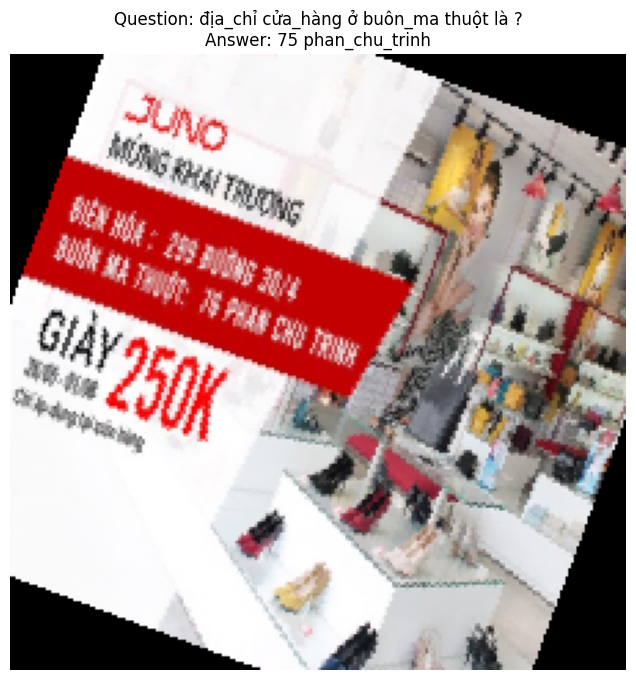

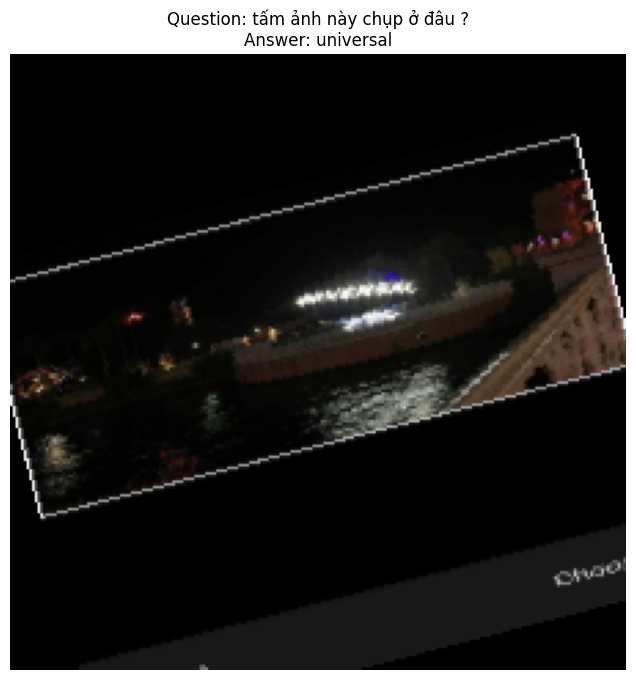

In [15]:
random_indices = np.random.choice(len(train_vlsp_dataset), 2)

for idx in random_indices:
    anno_id, img_id, image, question, answer = train_vlsp_dataset[idx]
    
    image = image.permute(1, 2, 0).numpy()
    
    plt.figure(figsize=(8, 8))
    plt.imshow(image)
    plt.title("Question: " + question + "\nAnswer: " + answer)
    plt.axis('off')
    plt.show()

In [16]:
train_loader = DataLoader(train_vlsp_dataset, batch_size=TRAIN_BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_vlsp_dataset, batch_size=VAL_BATCH_SIZE, shuffle=False)
len(train_loader), len(test_loader)

(2198, 100)

In [17]:
anno_id, img_id, image, quesiton, answer = next(enumerate(train_loader))[1]
len(answer), len(image), len(quesiton)

(16, 16, 16)

# Using Pretrain for VQA

### Image Embedding: ViT

In [18]:
image_model_name = "google/vit-base-patch16-224-in21k"
class ImageEmbedding(nn.Module):
    def __init__(self):
        super(ImageEmbedding, self).__init__()
        self.process = AutoImageProcessor.from_pretrained(image_model_name)
        self.model = ViTModel.from_pretrained(image_model_name)
        #self.model = nn.Sequential(*list(self.model.children())[:3])
        
        for param in self.model.parameters():
            param.requires_grad = False

    def forward(self, image, image_ids):
        inputs = self.process(image, return_tensors="pt")
        with torch.no_grad():
            outputs = self.model(**inputs.to(device))
            
        image_embedding = outputs.last_hidden_state
        return image_embedding, image_ids

### Question Embedding: PhoBert

In [19]:
text_model_name = "vinai/phobert-base"
class QuesEmbedding(nn.Module):
    def __init__(self, input_size=768, output_size=768):
        super(QuesEmbedding, self).__init__()
        self.tokenizer = AutoTokenizer.from_pretrained(text_model_name)
        self.phobert = AutoModel.from_pretrained(text_model_name)
        self.lstm = nn.LSTM(input_size, output_size, batch_first=True)

    def forward(self, ques):
        tokenized_input = self.tokenizer(ques, 
                                         return_tensors='pt', 
                                         padding='max_length', 
                                         max_length=MAX_LEN, 
                                         truncation=True, 
                                         add_special_tokens=False)
        ques = self.phobert(**tokenized_input.to(device)).last_hidden_state
        _, (h, _) = self.lstm(ques)
        return h.squeeze(0)

### Test Batch 

In [20]:
image_model = ImageEmbedding().to(device)
ques_model = QuesEmbedding().to(device)

for batch in train_loader:
    anno_ids, img_ids, images, questions, answers = batch
    if torch.cuda.is_available():
        images = images.cuda()
        questions = questions
        anno_ids = anno_ids
    
    with torch.no_grad():
        image_embeddings, att_ids = image_model(images, image_ids=anno_ids)
        ques_embeddings = ques_model(questions)
    break    

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


It looks like you are trying to rescale already rescaled images. If the input images have pixel values between 0 and 1, set `do_rescale=False` to avoid rescaling them again.


In [21]:
print(image_embeddings.size())
print(att_ids.size())
print(ques_embeddings.size())

torch.Size([16, 197, 768])
torch.Size([16])
torch.Size([16, 768])


In [22]:
image_embeddings = image_embeddings.reshape(TRAIN_BATCH_SIZE, 768, -1).permute(0, 2, 1)
ques_embeddings = ques_embeddings.unsqueeze(1)
print(image_embeddings.size())
print(ques_embeddings.size())

torch.Size([16, 197, 768])
torch.Size([16, 1, 768])


# Stack Attention Networks

In [23]:
#Linear để giảm kích thước, không cần tile repeat mà đưa vào san để nhân luôn cuối cùng trả về vector attention mà ko cần phải flatten
class StackAttention(nn.Module):
    def __init__(self, d=768, k=512, dropout=True):
        super(StackAttention, self).__init__()
        self.ff_image = nn.Linear(d, k)
        self.ff_ques = nn.Linear(d, k)
        if dropout:
            self.dropout = nn.Dropout(p=0.5)
        self.ff_attention = nn.Linear(k, 1)

    def forward(self, vi, vq):
        # N * 49 * 768 -> N * 49 * 512
        hi = self.ff_image(vi)
        #print("hi size: ", hi.size())
        # N * 768 -> N * 512 -> N * 1 * 512
        hq = self.ff_ques(vq)
        #print("hq size: ", hq.size())
        # N * 49 * 512
        ha = F.tanh(hi + hq)
        #print("ha1 size: ", ha.size())
        if getattr(self, 'dropout'):
            ha = self.dropout(ha)
        #DONE
        
        # N * 49 * 512 -> N * 49 * 1 -> N * 49
        ha = self.ff_attention(ha).squeeze(dim=2)
        #print("ha2 size: ", ha.size())
        pi = F.softmax(ha)
        # (N * 49 * 1, N * 49 * 768) -> N * 768
        vi_attended = (pi.unsqueeze(dim=2) * vi).sum(dim=1)
        #print("vi~ size: ", vi_attended.size())
        #print("vq size: ", vq.size())
        u = vi_attended + vq.squeeze(1)
        return u

In [24]:
san_model = StackAttention(d=768, k=512, dropout=True).to(device)
img_text_att = san_model(image_embeddings.to(device), ques_embeddings.to(device))
img_text_att.size()

/tmp/ipykernel_32/2416429134.py:28: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  pi = F.softmax(ha)


torch.Size([16, 768])

# Generate Answer

## Answers Embedding

In [25]:
class AnsEmbedding(nn.Module):
    def __init__(self, input_size=768):
        super(AnsEmbedding, self).__init__()
        self.tokenizer = AutoTokenizer.from_pretrained(text_model_name)
        self.phobert_embed = AutoModel.from_pretrained(text_model_name).embeddings.to(device)

    def forward(self, ans):  
        tokenized_input = self.tokenizer(ans, 
                                         return_tensors='pt',
                                         padding='max_length', 
                                         max_length=MAX_LEN, 
                                         truncation=True, return_attention_mask=False)
        ans = self.phobert_embed(**tokenized_input.to(device))
        return tokenized_input['input_ids'], ans

In [26]:
ans_model = AnsEmbedding().to(device)

for batch in train_loader:
    anno_id, img_id, images, questions, answers = batch
    if torch.cuda.is_available():
        answers = answers
    with torch.no_grad():
        ans_tokens, answers_embedding = ans_model(answers)
    break   
ans_tokens.size(), answers_embedding.size() 

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


(torch.Size([16, 40]), torch.Size([16, 40, 768]))

In [27]:
print(answers_embedding.size())
print(img_text_att.size())

torch.Size([16, 40, 768])
torch.Size([16, 768])


# Decoder

In [28]:
def scaled_dot_product(q, k, v, mask=None):
    d_k = q.size()[-1] 
    scaled = torch.matmul(q, k.transpose(-1, -2)) / math.sqrt(d_k) 
    if mask is not None:
        scaled += mask 
    attention = F.softmax(scaled, dim=-1) 
    values = torch.matmul(attention, v)
    return values, attention


class PositionwiseFeedForward(nn.Module):
    def __init__(self, d_model, hidden, drop_prob=0.1):
        super(PositionwiseFeedForward, self).__init__()
        self.linear1 = nn.Linear(d_model, hidden)
        self.linear2 = nn.Linear(hidden, d_model)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(p=drop_prob)

    def forward(self, x):
        x = self.linear1(x)
        x = self.relu(x)
        x = self.dropout(x) 
        x = self.linear2(x)
        return x


class LayerNormalization(nn.Module):
    def __init__(self, parameters_shape, eps=1e-5):
        super().__init__()
        self.parameters_shape=parameters_shape
        self.eps=eps
        self.gamma = nn.Parameter(torch.ones(parameters_shape)) # 512
        self.beta =  nn.Parameter(torch.zeros(parameters_shape)) # 512

    def forward(self, inputs):
        dims = [-(i + 1) for i in range(len(self.parameters_shape))] # [-1]
        mean = inputs.mean(dim=dims, keepdim=True) 
        var = ((inputs - mean) ** 2).mean(dim=dims, keepdim=True)
        std = (var + self.eps).sqrt() 
        y = (inputs - mean) / std 
        out = self.gamma * y  + self.beta  
        return out

class MaskMultiHeadAttention(nn.Module):

    def __init__(self, d_model, num_heads):
        super().__init__()
        self.d_model = d_model
        self.num_heads = num_heads
        self.head_dim = d_model // num_heads
        self.qkv_layer = nn.Linear(d_model , 3 * d_model) 
        self.linear_layer = nn.Linear(d_model, d_model)
    
    def forward(self, x, mask):
        batch_size, sequence_length, d_model = x.size() 
        qkv = self.qkv_layer(x) 
        qkv = qkv.reshape(batch_size, sequence_length, self.num_heads, 3 * self.head_dim)
        qkv = qkv.permute(0, 2, 1, 3) 
        q, k, v = qkv.chunk(3, dim=-1) 
        values, attention = scaled_dot_product(q, k, v, mask) 
        values = values.reshape(batch_size, sequence_length, self.num_heads * self.head_dim) 
        out = self.linear_layer(values) # 30 x 200 x 512
        return out # 30 x 200 x 512


class MultiHeadCrossAttention(nn.Module):

    def __init__(self, d_model, num_heads):
        super().__init__()
        self.d_model = d_model
        self.num_heads = num_heads
        self.head_dim = d_model // num_heads
        self.kv_layer = nn.Linear(d_model , 2 * d_model) # 1024
        self.q_layer = nn.Linear(d_model , d_model)
        self.linear_layer = nn.Linear(d_model, d_model)
    
    def forward(self, x, y, mask=None):
        batch_size, sequence_length, d_model = x.size()
        kv = self.kv_layer(x) 
        q = self.q_layer(y) 
        kv = kv.reshape(batch_size, sequence_length, self.num_heads, 2 * self.head_dim)
        q = q.reshape(batch_size, sequence_length, self.num_heads, self.head_dim) 
        kv = kv.permute(0, 2, 1, 3) 
        q = q.permute(0, 2, 1, 3) 
        k, v = kv.chunk(2, dim=-1) 
        values, attention = scaled_dot_product(q, k, v, mask) 
        values = values.reshape(batch_size, sequence_length, d_model) 
        out = self.linear_layer(values)
        return out  


class DecoderLayer(nn.Module):

    def __init__(self, d_model, ffn_hidden, num_heads, drop_prob):
        super(DecoderLayer, self).__init__()
        self.self_attention = MaskMultiHeadAttention(d_model=d_model, num_heads=num_heads)
        self.norm1 = LayerNormalization(parameters_shape=[d_model])
        self.dropout1 = nn.Dropout(p=drop_prob)
        self.encoder_decoder_attention = MultiHeadCrossAttention(d_model=d_model, num_heads=num_heads)
        self.norm2 = LayerNormalization(parameters_shape=[d_model])
        self.dropout2 = nn.Dropout(p=drop_prob)
        self.ffn = PositionwiseFeedForward(d_model=d_model, hidden=ffn_hidden, drop_prob=drop_prob)
        self.norm3 = LayerNormalization(parameters_shape=[d_model])
        self.dropout3 = nn.Dropout(p=drop_prob)

    def forward(self, x, y, decoder_mask):
        _y = y
        y = self.self_attention(y, mask=decoder_mask)
        y = self.dropout1(y)
        y = self.norm1(y + _y)

        _y = y # 30 x 200 x 512
        y = self.encoder_decoder_attention(x, y, mask=None)
        y = self.dropout2(y)
        y = self.norm2(y + _y)

        _y = y 
        y = self.ffn(y) 
        y = self.dropout3(y)
        y = self.norm3(y + _y) 
        return y 

class SequentialDecoder(nn.Sequential):
    def forward(self, *inputs):
        x, y, mask = inputs
        for module in self._modules.values():
            y = module(x, y, mask)
        return y

class Decoder(nn.Module):
    def __init__(self, d_model, ffn_hidden, num_heads, drop_prob, num_layers=1):
        super().__init__()
        self.layers = SequentialDecoder(*[DecoderLayer(d_model, ffn_hidden, num_heads, drop_prob) 
                                          for _ in range(num_layers)])

    def forward(self, x, y, mask):
        y = self.layers(x, y, mask)
        return y

In [29]:
d_model = 768
num_heads = 8
drop_prob = 0.1
batch_size = 30
max_sequence_length = MAX_LEN
ffn_hidden = 2048
num_layers = 5

x = img_text_att.unsqueeze(1).expand(-1, max_sequence_length, -1).to(device) # 16 * 768 -> 16 * 48 * 1024
y = answers_embedding.to(device) #16 * 48 * 768
mask = torch.full([max_sequence_length, max_sequence_length] , float('-inf'))
mask = torch.triu(mask, diagonal=1).to(device)
decoder = Decoder(d_model, ffn_hidden, num_heads, drop_prob, num_layers).to(device)
out = decoder(x, y, mask).to(device)

In [30]:
vocab_size = len(vocab)

linear_layer = nn.Linear(d_model, vocab_size).to(device)
output_logits = linear_layer(out)
output_probs = F.softmax(output_logits, dim=2)
output_probs.size()

torch.Size([16, 40, 64001])

### Test predict and tokenizer with 1 batch

In [31]:
from transformers import PhobertTokenizer
tokenizer = PhobertTokenizer.from_pretrained("vinai/phobert-base")

decoder_output = output_probs
predicted_tokens = decoder_output.argmax(dim=2)

def tokens_to_text(tokens, tokenizeFcr):
    return [tokenizer.decode(token.item()) for token in tokens]

for i in range(16):
    generated_text = tokens_to_text(predicted_tokens[i], tokenizer)
    print(f"Generated text for example {i}: {' '.join(generated_text)}")

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Generated text for example 0: t y _ @ @ c ổ _ đ ộ n g 1 4 9 @ @ S i m o n _ @ @ ả i _ p h â n _ c á c h 6 7 % m ũ i _ n h ọ n N g u y ễ n _ T h ị _ K i m _ @ @ p h ò n g _ n g ự m ũ i _ n h ọ n n h ằ n S ữ @ @ T ư ơ n g _ @ @ 1 9 3 4 1 9 3 4 N g u y ễ n _ T h ị _ K i m _ @ @ ẹ ẹ h à _ @ @ ẹ t h ự c _ @ @ b ả o _ l ư u s i z e t á n t á n O t t o _ @ @ t e n b r i n k F e y @ @ t e n b r i n k t e n b r i n k b ả o _ l ư u d _ M @ @ n h ằ n h à _ @ @ N g u y ễ n _ V ă n _ T o à n l i ệ t _ k ê N g u y ễ n _ T h ị _ K i m _ @ @ l i ệ t _ k ê l i ệ t _ k ê l i ệ t _ k ê
Generated text for example 1: F r a s e r T h ư ơ n g _ m ạ i _ đ i ệ n _ t ử k ý _ k ế t ả i _ p h â n _ c á c h ả i _ p h â n _ c á c h ẹ m ũ i _ n h ọ n m ũ i _ n h ọ n p h ò n g _ n g ự s o n _ M @ @ N ổ i _ t i ế n g F u n d @ @ l i ệ t _ k ê s o n _ M @ @ i l l e r N g u y ễ n _ T h ị _ K i m _ @ @ h à _ @ @ h à _ @ @ 儀 @ @ 儀 @ @ t h ự c _ @ @ b ả o _ l ư u s i z e t á n t á n O t t o _ @ @ k e t h ạ n _ d ù n g h ạ 

# VQA Model

In [32]:
class VQAModel(nn.Module):

    def __init__(self, vocab_size=64001, output_size=768, d_model=768, num_head=8, ffn_hidden=2048, drop_prob=0.3, num_layers=6, num_att_layers=4, mode='train'):
        super(VQAModel, self).__init__()
        self.mode = mode
        self.image_model = ImageEmbedding().to(device)
        self.ques_model = QuesEmbedding().to(device)
        self.ans_model = AnsEmbedding().to(device)
        
        self.san_model = nn.ModuleList(
            [StackAttention(d=d_model, k=512, dropout=True)] * num_att_layers).to(device)
        
        self.tanh = nn.Tanh()
        self.dropout = nn.Dropout(0.5)
        
        self.decoder = Decoder(d_model, ffn_hidden, num_heads, drop_prob, num_layers).to(device)
        
        self.mlp = nn.Sequential(
            nn.Dropout(p=0.3),
            nn.Linear(d_model, vocab_size))

    def forward(self, images, questions, answers, anno_ids, mask, mode, max_len=MAX_LEN):
        image_embeddings, att_ids = self.image_model(images.to(device), image_ids=anno_ids)
        if mode == 'train':
            image_embedds = image_embeddings.reshape(TRAIN_BATCH_SIZE, 768, -1).permute(0, 2, 1)
        else:
            image_embedds = image_embeddings.reshape(VAL_BATCH_SIZE, 768, -1).permute(0, 2, 1)
        
        ques_embeddings = self.ques_model(questions)
        ques_embedds = ques_embeddings.unsqueeze(1)
        
        for att_layer in self.san_model:
            att_embedds = att_layer(image_embedds.to(device), ques_embedds.to(device))
        
        att_embedds = self.tanh(att_embedds)
        att_embedds = self.dropout(att_embedds)
        
        #START DECODER
        ans_vocab, ans_embedds = self.ans_model(answers)
        
        x = att_embedds.to(device).unsqueeze(1).expand(-1, max_len, -1).to(device) # 16 * 768 -> 16 * 48 * 768
        y = ans_embedds # 16 * 48 * 768
        #print(x)
        #print(y.size())
        if mask == False:
            out = self.decoder(x, y, mask=None).to(device)
        else:
            mask = torch.full([max_len, max_len] , float('-inf'))
            mask = torch.triu(mask, diagonal=1).to(device)
        
            out = self.decoder(x, y, mask).to(device)
        #END DECODER
        #print(out)
        output_logits = self.mlp(out)
        return output_logits, ans_vocab

## Training

In [33]:
model = VQAModel().to(device)
criterion = nn.CrossEntropyLoss(ignore_index=1)
optimizer = optim.AdamW(model.parameters(), lr=1e-5, weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=EPOCHS)

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [34]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f'The model has {count_parameters(model):,} trainable parameters.')

The model has 286,348,290 trainable parameters.


In [35]:
vocab_swap = {value: key for key, value in vocab.items()}

In [36]:
def load_checkpoint(filepath):
    checkpoint = torch.load(filepath)
    model = checkpoint['model']
    model.load_state_dict(checkpoint['state_dict'])
    for parameter in model.parameters():
        parameter.requires_grad = False
    
    model.eval()
    
    return model

model = load_checkpoint('/kaggle/input/model-vqa-cv/ViT_PhoBert_v3.pt').to(device)

In [37]:
# def bleu_score(actual, predict): 
#     ###

In [39]:
num_epochs = 1  # Chỉ chạy 1 epoch để test
print_every = 1  # In ra ngay lập tức

losses = []
for epoch in tqdm(range(num_epochs), desc="Epochs"):
    model.train()
    total_loss = 0.0
    for batch_idx, batch in enumerate(train_loader):
        anno_id, img_id, images, questions, answers = batch
        if len(images) == TRAIN_BATCH_SIZE:
            # Chỉ lấy một mẫu dữ liệu từ batch
            images = images[:1].to(device)  # Lấy 1 ảnh
            questions = [questions[0]]      # Lấy 1 câu hỏi
            answers = [answers[0]]          # Lấy 1 câu trả lời
            anno_id = [anno_id[0]]          # Lấy 1 anno_id

            predicted_tokens, ans_embedds = model(images, questions, answers, anno_id, mode='test', mask=True)
            predicted_tokens = predicted_tokens.float()
            ans_embedds = ans_embedds.long()

            # Xử lý dự đoán cho mẫu duy nhất
            sentence_predicted = torch.argmax(predicted_tokens[0], axis=1)
            predicted_sentence = ""
            for idx in sentence_predicted:
                predicted_sentence += vocab_swap[idx.item()] + " "
                if idx == 2:
                    break

            print(f"Epoch [{epoch + 1}/{num_epochs}], Batch [{batch_idx + 1}/{len(train_loader)}]")
            print(f"Question: {questions[0]}")
            print(f"Answer: {answers[0]}")
            print(f"Answer Prediction: {predicted_sentence}")

            loss = criterion(predicted_tokens.permute(0, 2, 1), ans_embedds)

            optimizer.zero_grad()
            optimizer.step()
            scheduler.step()
            total_loss += loss.item()
            losses.append(loss.item())

            print(f"Loss: {loss.item():.4f}")
            break  # Thoát sau khi xử lý 1 mẫu
    print(f"Epoch [{epoch + 1}/{num_epochs}], Average Loss: {total_loss:.4f}")
    break  # Thoát sau 1 epoch

Epochs:   0%|          | 0/1 [00:00<?, ?it/s]/tmp/ipykernel_32/2416429134.py:28: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  pi = F.softmax(ha)
Epochs:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1/1], Batch [1/2198]
Question: cửa_hàng ở phía bên trái ngoài cùng có tên là gì ?
Answer: unatoto
Answer Prediction: <s> un@@ ngon to </s> 
Loss: 1.9359
Epoch [1/1], Average Loss: 1.9359


In [40]:
def evaluate(model, test_loader, criterion, vocab_swap, device, print_every=1, max_len=50):
    model.eval()  # Chuyển sang chế độ đánh giá
    test_losses = []
    total_loss = 0.0
    
    with torch.no_grad():  # Tắt tính toán gradient
        for batch_idx, batch in enumerate(tqdm(test_loader, desc="Evaluating")):
            anno_id, img_id, images, questions, answers = batch
            images = images.to(device)

            # Đảm bảo batch size hợp lệ
            batch_size = min(len(images), test_loader.batch_size)
            
            # Dự đoán với mask (cho loss) và không mask (cho kết quả cuối cùng)
            predicted_tokens, ans_embedds = model(images, questions, answers, anno_id, mode='test', mask=True)
            predicted_tokens = predicted_tokens.float()
            ans_embedds = ans_embedds.long()
            
            # Tính loss
            loss = criterion(predicted_tokens.permute(0, 2, 1), ans_embedds)
            total_loss += loss.item()
            test_losses.append(loss.item())
            
            # Dự đoán không mask để lấy câu trả lời
            predicted_tokens, _ = model(images, questions, answers, anno_id, mode='test', mask=False)
            predicted_tokens = predicted_tokens.float()
            
            # In thông tin cho mỗi mẫu trong batch
            for i in range(batch_size):
                sentence_predicted = torch.argmax(predicted_tokens[i], axis=1)
                predicted_sentence = ""
                for idx in sentence_predicted:
                    predicted_sentence += vocab_swap[idx.item()] + " "
                    if idx == 2:  # Dừng khi gặp token kết thúc
                        break
                
                if (batch_idx + 1) % print_every == 0:
                    print(f"Batch [{batch_idx + 1}/{len(test_loader)}], Sample [{i + 1}/{batch_size}]")
                    print(f"Question: {questions[i]}")
                    print(f"Generated Answer: {predicted_sentence.strip()}")
                    print(f"Actual Answer: {answers[i]}")
                    print(f"Loss: {loss.item():.4f}")
                    print("----------------------------")
            
            # Hiển thị ảnh (chuyển tensor về numpy và chỉ hiển thị ảnh đầu tiên trong batch)
            if (batch_idx + 1) % print_every == 0:
                img = images[0].cpu().permute(1, 2, 0).numpy()  # Chuyển từ (C, H, W) sang (H, W, C)
                plt.imshow(img)
                plt.axis('off')
                plt.show()
        
        # In loss trung bình
        avg_loss = total_loss / len(test_loader)
        print(f"Average Test Loss: {avg_loss:.4f}")
    
    return test_losses, avg_loss

Evaluating:   0%|          | 0/100 [00:00<?, ?it/s]

Batch [1/100], Sample [1/1]
Question: số điện_thoại của cửa_hàng là bao_nhiêu ?
Generated Answer: <s> 05@@ 62 000 100 </s>
Actual Answer: 0562 000 100
Loss: 0.1262
----------------------------


/tmp/ipykernel_32/2416429134.py:28: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  pi = F.softmax(ha)


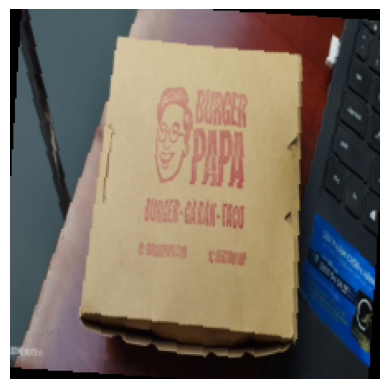

Evaluating:   1%|          | 1/100 [00:00<00:39,  2.50it/s]

Batch [2/100], Sample [1/1]
Question: địa_chỉ website của của hàng là gì ?
Generated Answer: <s> phụ g@@ pap@@ a . com </s>
Actual Answer: burgerpapa . com
Loss: 3.4688
----------------------------


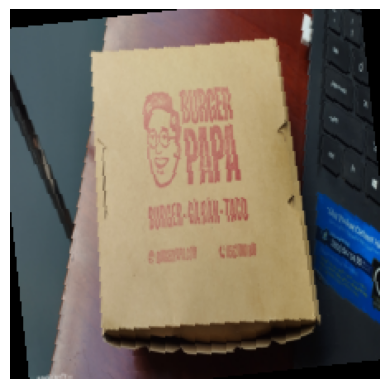

Evaluating:   2%|▏         | 2/100 [00:00<00:34,  2.85it/s]

Batch [3/100], Sample [1/1]
Question: tên cửa_hàng là gì ?
Generated Answer: <s> 2022 op a </s>
Actual Answer: burger papa
Loss: 2.4699
----------------------------


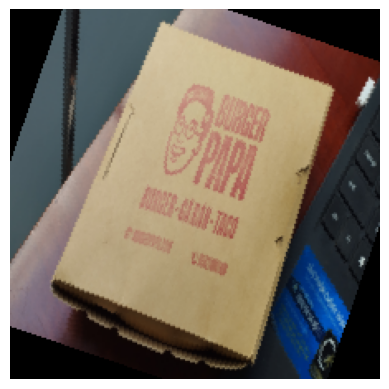

Evaluating:   3%|▎         | 3/100 [00:01<00:31,  3.04it/s]

Batch [4/100], Sample [1/1]
Question: tên cửa_hàng bán món gì ?
Generated Answer: <s> 2022 - gà rán - t@@ aco </s>
Actual Answer: burger - gà rán - taco
Loss: 1.3848
----------------------------


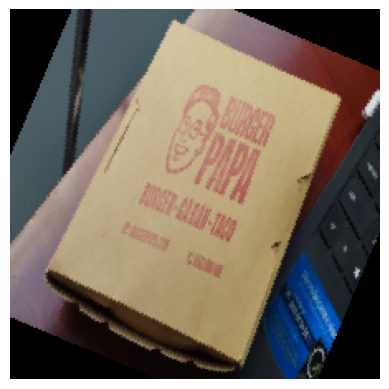

Evaluating:   4%|▍         | 4/100 [00:01<00:30,  3.12it/s]

Batch [5/100], Sample [1/1]
Question: tên của cửa tiệm này là gì ?
Generated Answer: <s> bánh_mì pe@@ w@@ pe@@ w </s>
Actual Answer: bánh_mì pewpew
Loss: 0.1340
----------------------------


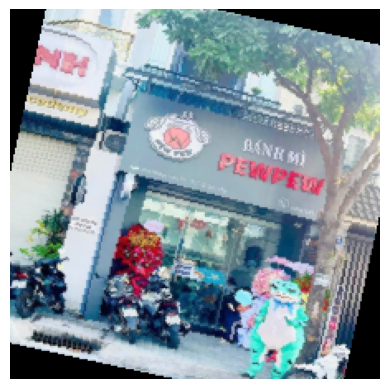

Evaluating:   5%|▌         | 5/100 [00:01<00:30,  3.09it/s]

Batch [6/100], Sample [1/1]
Question: địa_chỉ của của hàng ở đâu ?
Generated Answer: <s> 605 ph@@ an_@@ vă@@ n_trị , p . 7 , q . gò vấp </s>
Actual Answer: 605 phan_văn_trị , p . 7 , q . gò vấp
Loss: 0.8398
----------------------------


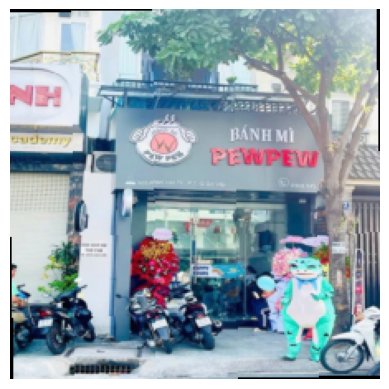

Evaluating:   6%|▌         | 6/100 [00:01<00:29,  3.16it/s]

Batch [7/100], Sample [1/1]
Question: trường này là trường gì ?
Generated Answer: <s> trường trung_học_cơ_sở </s>
Actual Answer: trường trung_học_cơ_sở
Loss: 0.9384
----------------------------


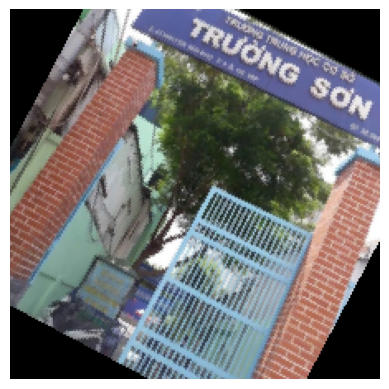

Evaluating:   7%|▋         | 7/100 [00:02<00:27,  3.43it/s]

Batch [8/100], Sample [1/1]
Question: tên cửa của trường này là gì ?
Generated Answer: <s> trường sơn </s>
Actual Answer: trường sơn
Loss: 0.0009
----------------------------


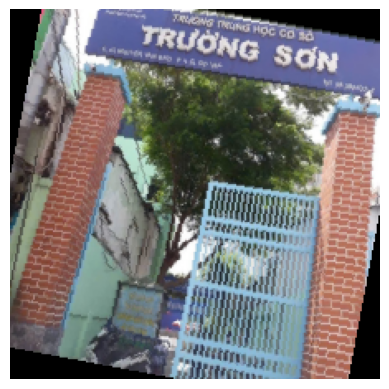

Evaluating:   8%|▊         | 8/100 [00:02<00:25,  3.61it/s]

Batch [9/100], Sample [1/1]
Question: địa_chỉ của trường này ở đâu ?
Generated Answer: <s> 43 nguy@@ en van nguyên p 4 q . go va@@ p </s>
Actual Answer: 43 nguyen van bao_p 4 q . go vap
Loss: 1.0912
----------------------------


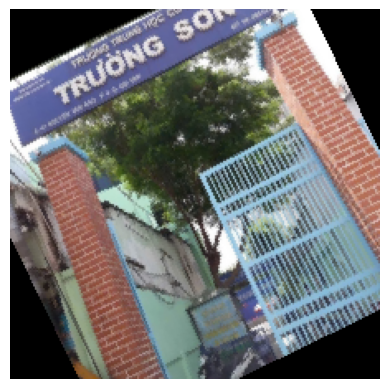

Evaluating:   9%|▉         | 9/100 [00:02<00:25,  3.53it/s]

Batch [10/100], Sample [1/1]
Question: số điện_thoại của trường là gì ?
Generated Answer: <s> 08 . 38@@ 94@@ 23 6 </s>
Actual Answer: 08 . 389423 6
Loss: 0.3420
----------------------------


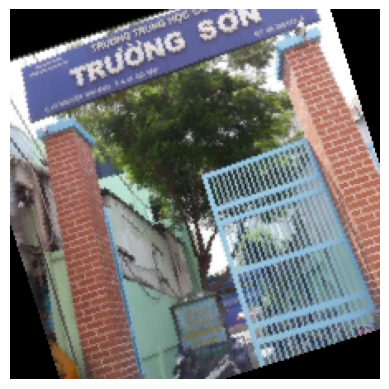

Evaluating:  10%|█         | 10/100 [00:03<00:25,  3.52it/s]

Batch [11/100], Sample [1/1]
Question: tên của cửa tiệm này là gì ?
Generated Answer: <s> làm 4 </s>
Actual Answer: bèo 4
Loss: 1.8799
----------------------------


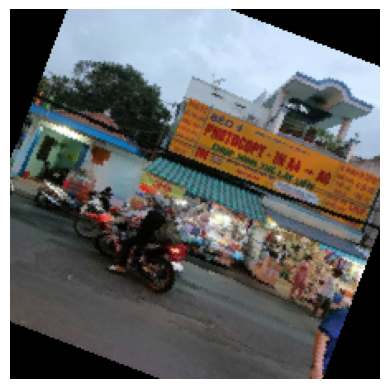

Evaluating:  11%|█         | 11/100 [00:03<00:25,  3.46it/s]

Batch [12/100], Sample [1/1]
Question: ngoài chụp hình lấy liền thì tiệm bèo 4 này còn kinh_doanh gì ?
Generated Answer: <s> in - in a@@ 4 - ao </s>
Actual Answer: photocopy - in a4 - ao
Loss: 0.9713
----------------------------


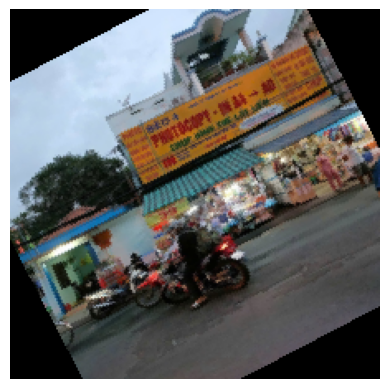

Evaluating:  12%|█▏        | 12/100 [00:03<00:25,  3.49it/s]

Batch [13/100], Sample [1/1]
Question: trà cam tươi_ép có_giá bao_nhiêu ?
Generated Answer: <s> 25 k </s>
Actual Answer: 25 k
Loss: 0.0007
----------------------------


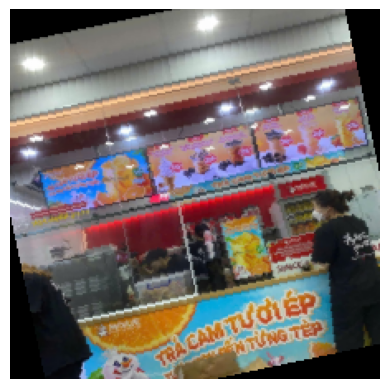

Evaluating:  13%|█▎        | 13/100 [00:03<00:25,  3.45it/s]

Batch [14/100], Sample [1/1]
Question: số điện_thoại hotline_nhượng quyền là bao_nhiêu ?
Generated Answer: <s> 0@@ 24 666 21@@ 11 </s>
Actual Answer: 024 666 2111
Loss: 1.0631
----------------------------


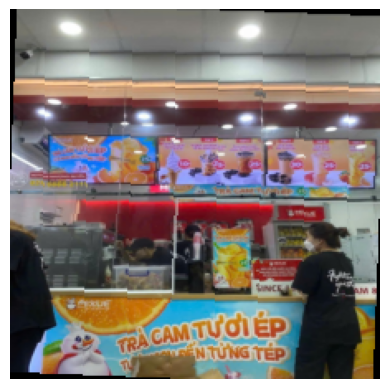

Evaluating:  14%|█▍        | 14/100 [00:04<00:25,  3.39it/s]

Batch [15/100], Sample [1/1]
Question: quán này tên là gì ?
Generated Answer: <s> 2019 co@@ ffee </s>
Actual Answer: minicoffee
Loss: 2.9478
----------------------------


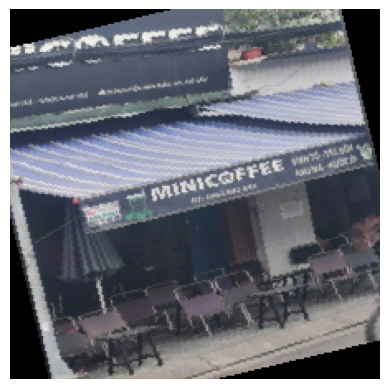

Evaluating:  15%|█▌        | 15/100 [00:04<00:25,  3.37it/s]

Batch [16/100], Sample [1/1]
Question: quán này kinh_doanh cái gì ?
Generated Answer: <s> sinh_tố - trà sữa đông - nước ép </s>
Actual Answer: sinh_tố - trà sữa rau_má - nước ép
Loss: 1.7068
----------------------------


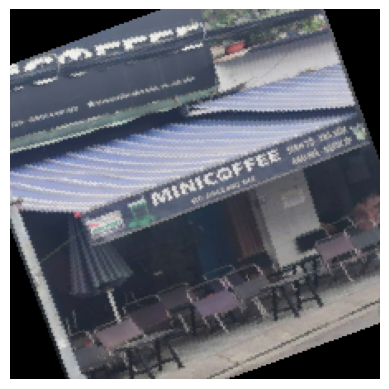

Evaluating:  16%|█▌        | 16/100 [00:04<00:24,  3.39it/s]

Batch [17/100], Sample [1/1]
Question: ngoài sinh_tố và trà sữa thì quán này còn kinh_doanh cái gì ?
Generated Answer: <s> thiên_@@ - nước ép </s>
Actual Answer: rau_má - nước ép
Loss: 2.4860
----------------------------


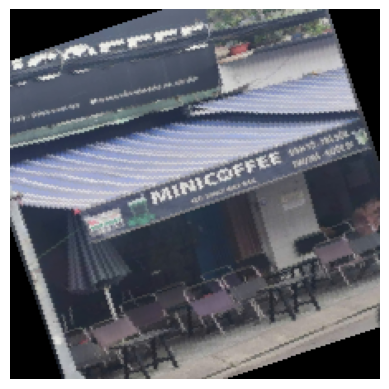

Evaluating:  17%|█▋        | 17/100 [00:05<00:24,  3.42it/s]

Batch [18/100], Sample [1/1]
Question: số điện_thoại của quán là gì ?
Generated Answer: <s> 09@@ 62 8@@ 82 nai </s>
Actual Answer: 0962 882 845
Loss: 1.1183
----------------------------


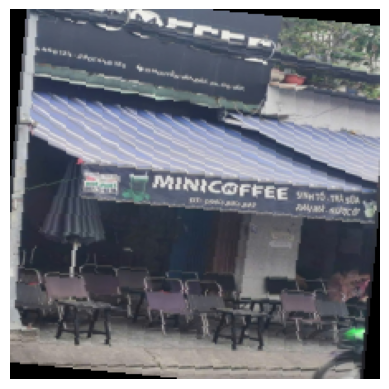

Evaluating:  18%|█▊        | 18/100 [00:05<00:24,  3.39it/s]

Batch [19/100], Sample [1/1]
Question: địa_chỉ của của quán này ở đâu ?
Generated Answer: <s> 15 nguy@@ ễn_@@ văn_@@ bảo , p@@ 4 . gò vấp </s>
Actual Answer: 15 nguyễn_văn_bảo , p4 . gò vấp
Loss: 0.0082
----------------------------


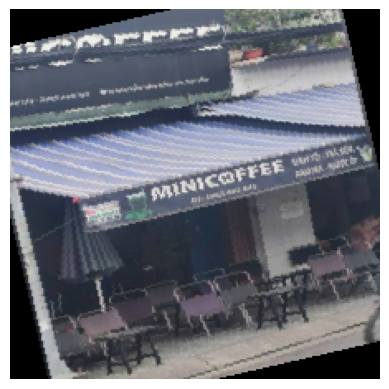

Evaluating:  19%|█▉        | 19/100 [00:05<00:23,  3.40it/s]

Batch [20/100], Sample [1/1]
Question: tên của trường này là gì ?
Generated Answer: <s> đại_học công_nghiệp t@@ p . h@@ cm </s>
Actual Answer: đại_học công_nghiệp tp . hcm
Loss: 0.1227
----------------------------


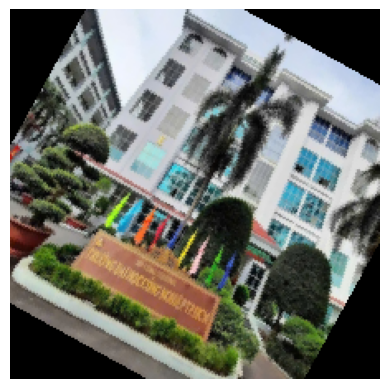

Evaluating:  20%|██        | 20/100 [00:05<00:23,  3.42it/s]

Batch [21/100], Sample [1/1]
Question: trường này thuộc bộ gì ?
Generated Answer: <s> công_thương </s>
Actual Answer: công_thương
Loss: 0.0647
----------------------------


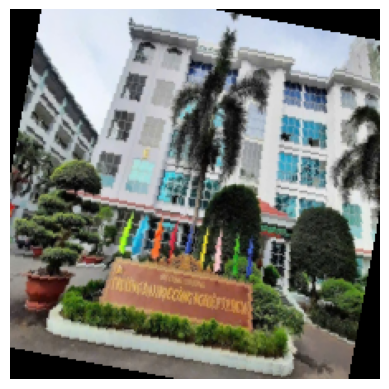

Evaluating:  21%|██        | 21/100 [00:06<00:22,  3.44it/s]

Batch [22/100], Sample [1/1]
Question: tờ tiên này thuộc ngân_hàng nhà_nước nào ?
Generated Answer: <s> việt_@@ nam </s>
Actual Answer: việt_nam
Loss: 0.0001
----------------------------


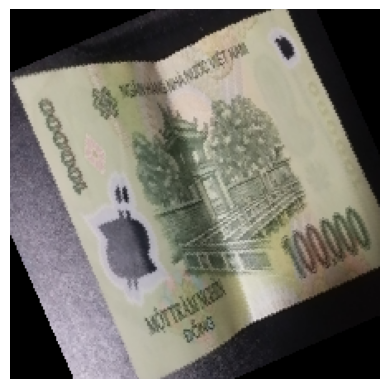

Evaluating:  22%|██▏       | 22/100 [00:06<00:23,  3.35it/s]

Batch [23/100], Sample [1/1]
Question: mệnh_giá trên tờ tiền này là bao_nhiêu ?
Generated Answer: <s> 100 . 000 </s>
Actual Answer: 100 . 000
Loss: 0.0006
----------------------------


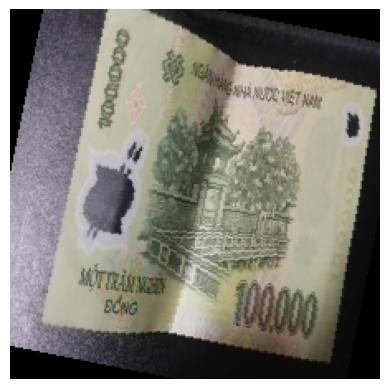

Evaluating:  23%|██▎       | 23/100 [00:06<00:22,  3.48it/s]

Batch [24/100], Sample [1/1]
Question: tên của hộp này là gì ?
Generated Answer: <s> nes@@ tle mil@@ o </s>
Actual Answer: nestle milo
Loss: 1.7283
----------------------------


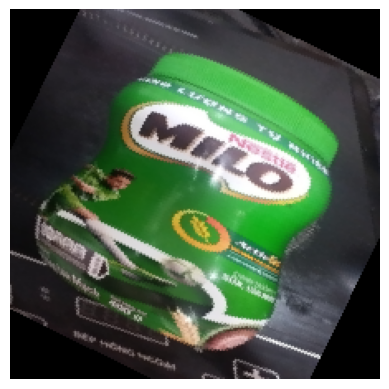

Evaluating:  24%|██▍       | 24/100 [00:07<00:22,  3.45it/s]

Batch [25/100], Sample [1/1]
Question: khối_lượng của hộp này là bao_nhiêu ?
Generated Answer: <s> 400 g </s>
Actual Answer: 400 g
Loss: 0.1604
----------------------------


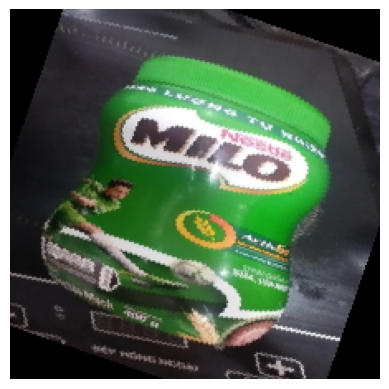

Evaluating:  25%|██▌       | 25/100 [00:07<00:20,  3.59it/s]

Batch [26/100], Sample [1/1]
Question: tên của sản_phẩm này là gì ?
Generated Answer: <s> cafe phố </s>
Actual Answer: cafe phố
Loss: 0.0051
----------------------------


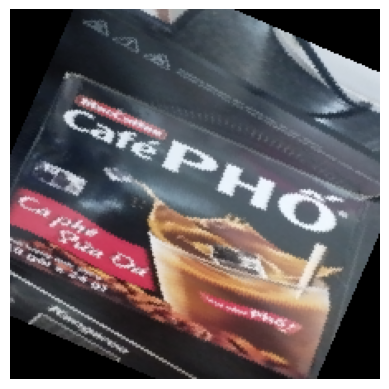

Evaluating:  26%|██▌       | 26/100 [00:07<00:21,  3.43it/s]

Batch [27/100], Sample [1/1]
Question: sản_phẩm này có khối_lượng bao_nhiêu ?
Generated Answer: <s> 06 g </s>
Actual Answer: 240 g
Loss: 1.4987
----------------------------


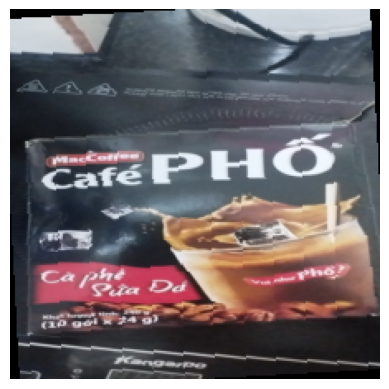

Evaluating:  27%|██▋       | 27/100 [00:08<00:21,  3.37it/s]

Batch [28/100], Sample [1/1]
Question: sản_phẩm này có tên là gì ?
Generated Answer: <s> mỹ@@ _h@@ ảo nước rửa chanh </s>
Actual Answer: mỹ_hảo nước rửa chén
Loss: 1.3820
----------------------------


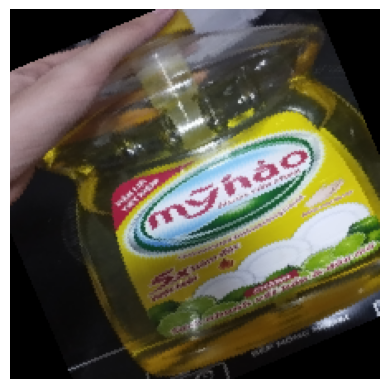

Evaluating:  28%|██▊       | 28/100 [00:08<00:22,  3.26it/s]

Batch [29/100], Sample [1/1]
Question: mã id của quyển sách này là gì ?
Generated Answer: <s> 08 000 </s>
Actual Answer: 200000
Loss: 2.2514
----------------------------


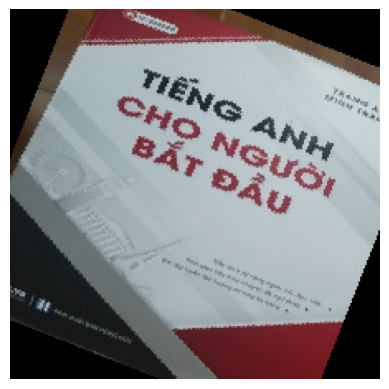

Evaluating:  29%|██▉       | 29/100 [00:08<00:21,  3.34it/s]

Batch [30/100], Sample [1/1]
Question: tựa đề của quyển sách này là gì ?
Generated Answer: <s> tiếng anh cho người mới bắt_đầu </s>
Actual Answer: tiếng anh cho người mới bắt_đầu
Loss: 0.6180
----------------------------


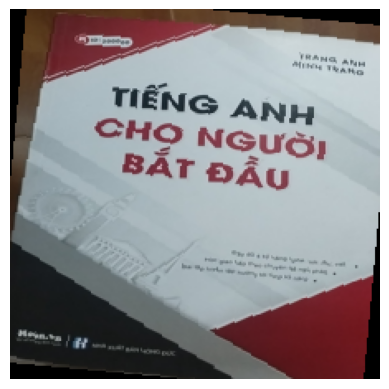

Evaluating:  30%|███       | 30/100 [00:08<00:20,  3.42it/s]

Batch [31/100], Sample [1/1]
Question: quyển sách này được xuất_bản bởi nhà_xuất_bản nào ?
Generated Answer: <s> hồng đức </s>
Actual Answer: hồng đức
Loss: 0.0032
----------------------------


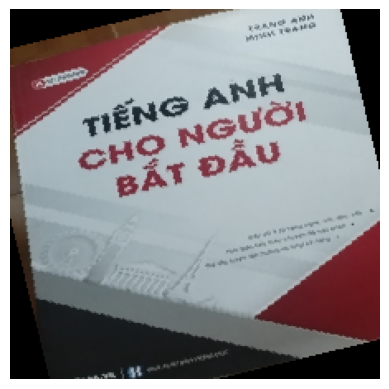

Evaluating:  31%|███       | 31/100 [00:09<00:19,  3.49it/s]

Batch [32/100], Sample [1/1]
Question: tác_giả của quyển sách là ai ?
Generated Answer: <s> trang anh mi@@ lễ_hội </s>
Actual Answer: trang anh minh_trang
Loss: 1.2052
----------------------------


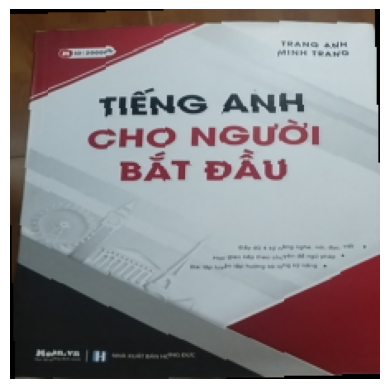

Evaluating:  32%|███▏      | 32/100 [00:09<00:19,  3.52it/s]

Batch [33/100], Sample [1/1]
Question: tác_giả của quyển sách là ai ?
Generated Answer: <s> o@@ g it in@@ </s>
Actual Answer: og mandino
Loss: 3.6633
----------------------------


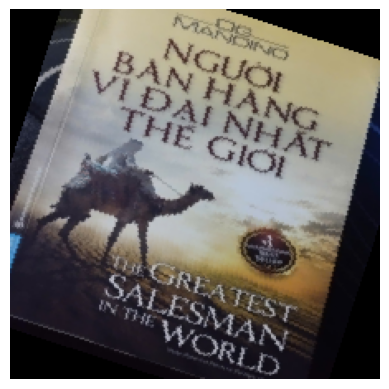

Evaluating:  33%|███▎      | 33/100 [00:09<00:19,  3.45it/s]

Batch [34/100], Sample [1/1]
Question: quyển sách này có tên tiếng việt là gì ?
Generated Answer: <s> người bán hàng vĩ_đại nhất thế_giới </s>
Actual Answer: người bán hàng vĩ_đại nhất thế_giới
Loss: 0.7158
----------------------------


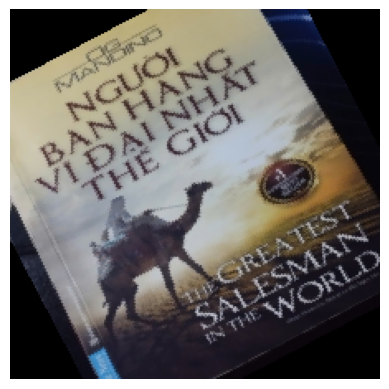

Evaluating:  34%|███▍      | 34/100 [00:10<00:19,  3.45it/s]

Batch [35/100], Sample [1/1]
Question: đặt_hàng trong bảng quảng_cáo bằng số điện_thoại nào ?
Generated Answer: <s> 0@@ store . 73 . 45 . 46 </s>
Actual Answer: 0389 . 73 . 45 . 46
Loss: 0.8608
----------------------------


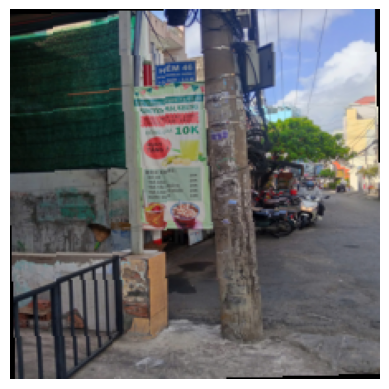

Evaluating:  35%|███▌      | 35/100 [00:10<00:20,  3.15it/s]

Batch [36/100], Sample [1/1]
Question: trong bảng quảng_cáo mua bao_nhiêu để được tặng 1 ?
Generated Answer: <s> 5 </s>
Actual Answer: 5
Loss: 0.0001
----------------------------


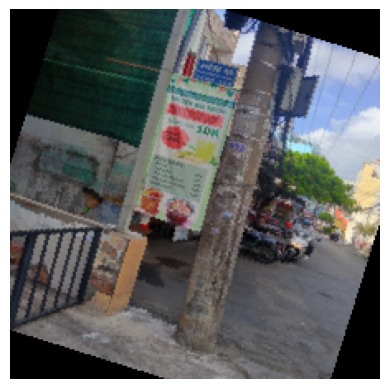

Evaluating:  36%|███▌      | 36/100 [00:10<00:20,  3.06it/s]

Batch [37/100], Sample [1/1]
Question: trong bảng quảng_cáo mua bao_nhiêu để được tặng 1 ?
Generated Answer: <s> 5 </s>
Actual Answer: 5
Loss: 0.0001
----------------------------


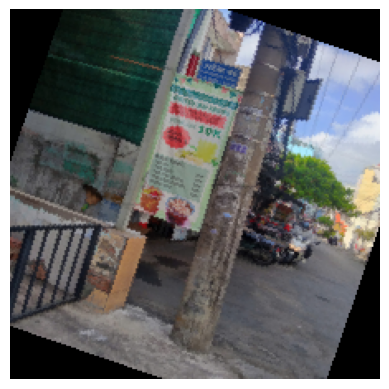

Evaluating:  37%|███▋      | 37/100 [00:11<00:21,  3.00it/s]

Batch [38/100], Sample [1/1]
Question: món đá me trong bảng quảng_cáo cáo có_giá bao_nhiêu ?
Generated Answer: <s> 20 k </s>
Actual Answer: 20 k
Loss: 0.0003
----------------------------


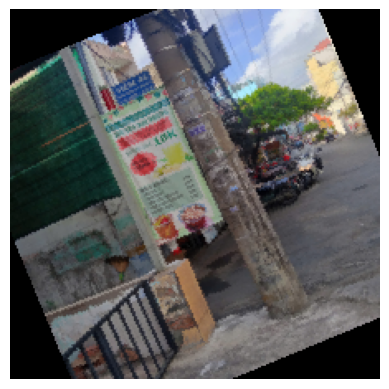

Evaluating:  38%|███▊      | 38/100 [00:11<00:21,  2.95it/s]

Batch [39/100], Sample [1/1]
Question: món nước dừa trong bảng quảng_cáo cáo có_giá bao_nhiêu ?
Generated Answer: <s> 18 k </s>
Actual Answer: 18 k
Loss: 0.0005
----------------------------


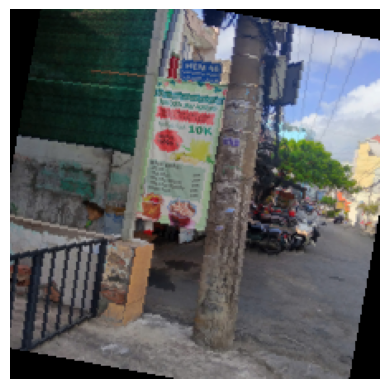

Evaluating:  39%|███▉      | 39/100 [00:11<00:20,  2.93it/s]

Batch [40/100], Sample [1/1]
Question: trong bảng quảng_cáo cáo nước mía các loại có_giá bao_nhiêu ?
Generated Answer: <s> đồng giá 10 k </s>
Actual Answer: đồng giá 10 k
Loss: 0.0002
----------------------------


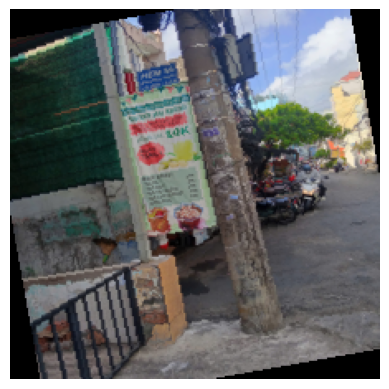

Evaluating:  40%|████      | 40/100 [00:12<00:20,  2.91it/s]

Batch [41/100], Sample [1/1]
Question: cửa tiệm này mở_cửa vào thời_gian nào ?
Generated Answer: <s> 6 h30 đến 21 h30 </s>
Actual Answer: 6 h30 đến 21 h30
Loss: 0.3738
----------------------------


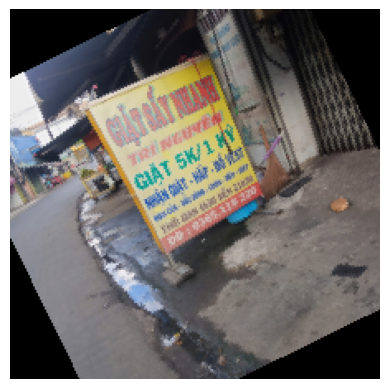

Evaluating:  41%|████      | 41/100 [00:12<00:20,  2.94it/s]

Batch [42/100], Sample [1/1]
Question: cửa tiệm này có tên là gì ?
Generated Answer: <s> a@@ nguy@@ ễn </s>
Actual Answer: trí nguyễn
Loss: 1.7044
----------------------------


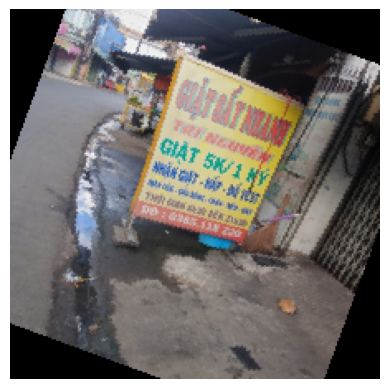

Evaluating:  42%|████▏     | 42/100 [00:12<00:20,  2.88it/s]

Batch [43/100], Sample [1/1]
Question: cửa tiệm này kinh_doanh gì ?
Generated Answer: <s> giặt sấy nhanh </s>
Actual Answer: giặt sấy nhanh
Loss: 0.5159
----------------------------


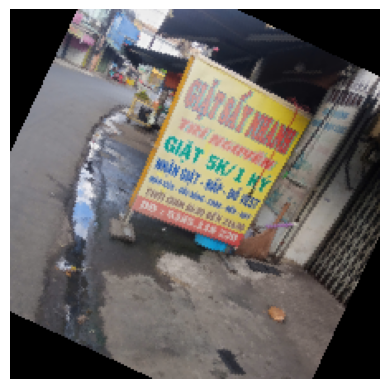

Evaluating:  43%|████▎     | 43/100 [00:13<00:18,  3.05it/s]

Batch [44/100], Sample [1/1]
Question: ở đây nhận giặt đồ_vật gì ?
Generated Answer: <s> màn cửa - gấu bông - chăn - siêu_thị - giày </s>
Actual Answer: màn cửa - gấu bông - chăn - mền - giày
Loss: 1.8628
----------------------------


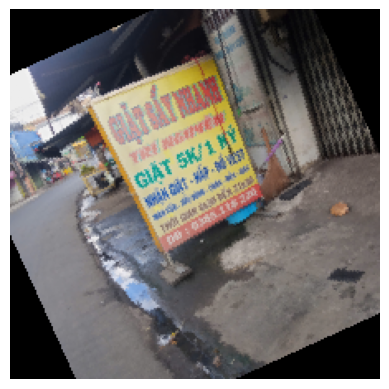

Evaluating:  44%|████▍     | 44/100 [00:13<00:17,  3.17it/s]

Batch [45/100], Sample [1/1]
Question: số điện_thoại của tiệm này là gì ?
Generated Answer: <s> 03@@ 85 . 118 220 </s>
Actual Answer: 0385 . 118 220
Loss: 0.9531
----------------------------


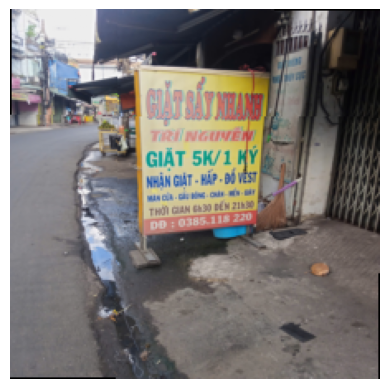

Evaluating:  45%|████▌     | 45/100 [00:13<00:17,  3.22it/s]

Batch [46/100], Sample [1/1]
Question: giá giặt ở cửa tiệm này bao_nhiêu ?
Generated Answer: <s> 5 k / 1 ký </s>
Actual Answer: 5 k / 1 ký
Loss: 0.0862
----------------------------


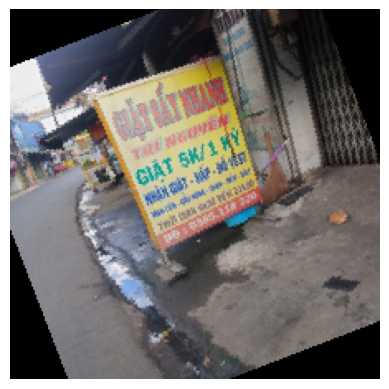

Evaluating:  46%|████▌     | 46/100 [00:14<00:16,  3.30it/s]

Batch [47/100], Sample [1/1]
Question: nhà_thuốc này có tên là gì ?
Generated Answer: <s> an khang </s>
Actual Answer: an khang
Loss: 0.5380
----------------------------


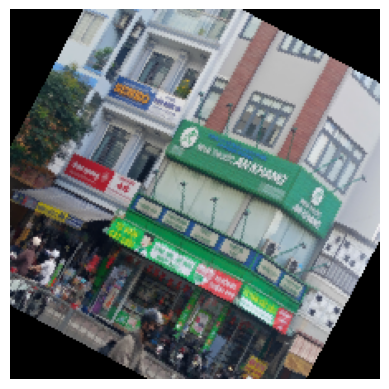

Evaluating:  47%|████▋     | 47/100 [00:14<00:16,  3.31it/s]

Batch [48/100], Sample [1/1]
Question: ngoài thuốc_tây thì nhà_thuốc này còn kinh_doanh cái gì ?
Generated Answer: <s> thực_phẩm chức_năng hoàn_@@ mỹ_phẩm thiết_bị y_tế </s>
Actual Answer: thực_phẩm chức_năng dược_mỹ_phẩm thiết_bị y_tế
Loss: 1.4694
----------------------------


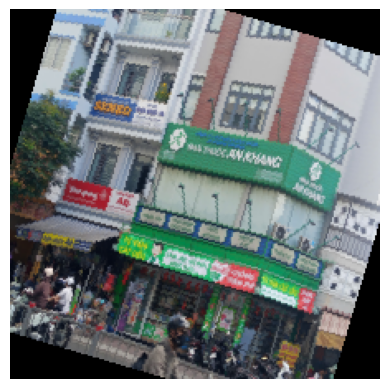

Evaluating:  48%|████▊     | 48/100 [00:14<00:15,  3.36it/s]

Batch [49/100], Sample [1/1]
Question: đây là trung_tâm gì ?
Generated Answer: <s> ngoại_ngữ </s>
Actual Answer: ngoại_ngữ
Loss: 0.5620
----------------------------


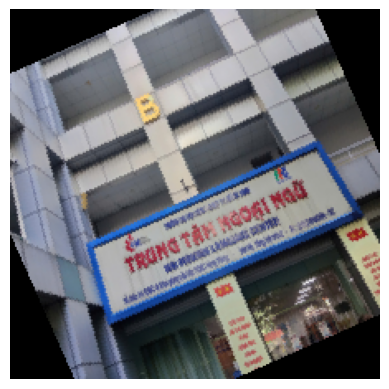

Evaluating:  49%|████▉     | 49/100 [00:14<00:16,  3.11it/s]

Batch [50/100], Sample [1/1]
Question: trung_tâm này thuộc trường nào ?
Generated Answer: <s> đại_học công_nghiệp t@@ p . hồ chí_@@ minh </s>
Actual Answer: đại_học công_nghiệp tp . hồ chí_minh
Loss: 0.1129
----------------------------


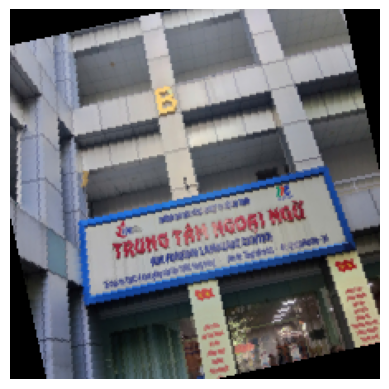

Evaluating:  50%|█████     | 50/100 [00:15<00:16,  3.05it/s]

Batch [51/100], Sample [1/1]
Question: địa_chỉ của trung_tâm này ở đâu ?
Generated Answer: <s> tầng kính nhà b </s>
Actual Answer: tầng trệt nhà b
Loss: 1.4120
----------------------------


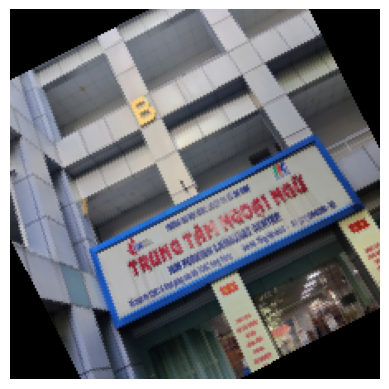

Evaluating:  51%|█████     | 51/100 [00:15<00:16,  3.05it/s]

Batch [52/100], Sample [1/1]
Question: số điện_thoại của trung_tâm là gì ?
Generated Answer: <s> ( 0@@ 28 ) 38@@ 9@@ 40@@ 36 - nhật_@@ </s>
Actual Answer: ( 028 ) 38940390 - 157
Loss: 1.1566
----------------------------


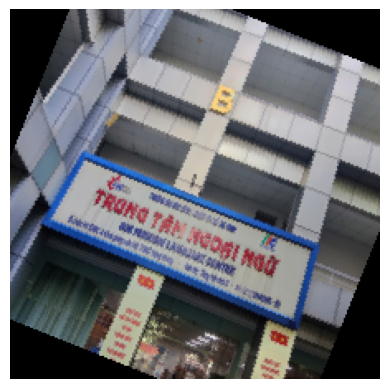

Evaluating:  52%|█████▏    | 52/100 [00:16<00:15,  3.02it/s]

Batch [53/100], Sample [1/1]
Question: cửa_hàng anh lộc là cửa_hàng gì ?
Generated Answer: <s> in - in - chụp ảnh thẻ </s>
Actual Answer: photocopy - in - chụp ảnh thẻ
Loss: 1.3098
----------------------------


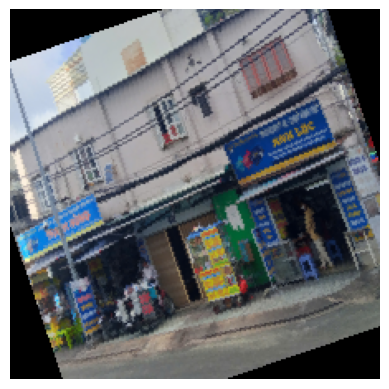

Evaluating:  53%|█████▎    | 53/100 [00:16<00:15,  2.97it/s]

Batch [54/100], Sample [1/1]
Question: cửa_hàng bên phải tấm ảnh có tên là gì ?
Generated Answer: <s> 00 u_l@@ ai </s>
Actual Answer: hiếu_lai
Loss: 2.2759
----------------------------


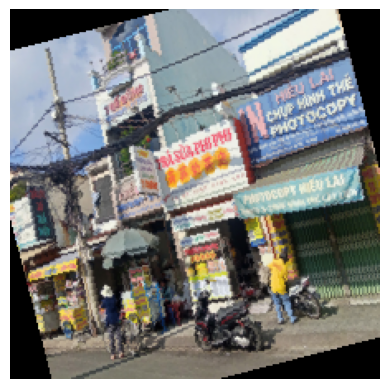

Evaluating:  54%|█████▍    | 54/100 [00:16<00:15,  2.90it/s]

Batch [55/100], Sample [1/1]
Question: giá hồng trà và lục_trà ở tiệm trà sữa phi_phi là bao_nhiêu ?
Generated Answer: <s> 7 . 000 đ / ly </s>
Actual Answer: 7 . 000 đ / ly
Loss: 0.0679
----------------------------


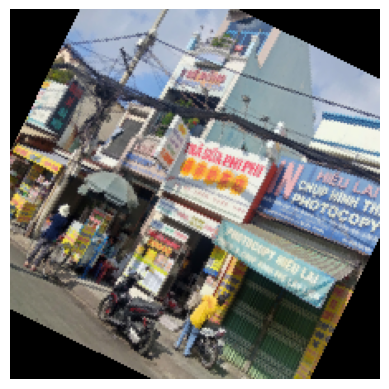

Evaluating:  55%|█████▌    | 55/100 [00:16<00:14,  3.07it/s]

Batch [56/100], Sample [1/1]
Question: giá trân châu_gia_truyền ở tiệm trà sữa phi_phi là bao_nhiêu ?
Generated Answer: <s> 3 . 000 đ </s>
Actual Answer: 3 . 000 đ
Loss: 0.0001
----------------------------


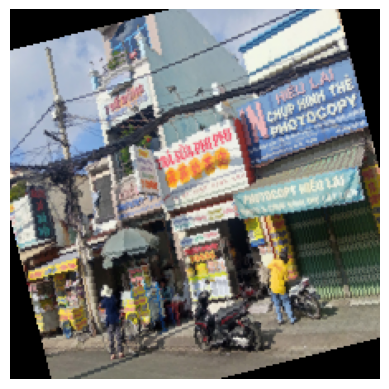

Evaluating:  56%|█████▌    | 56/100 [00:17<00:14,  3.11it/s]

Batch [57/100], Sample [1/1]
Question: cửa_hàng thế_đũng kinh_doanh gì ?
Generated Answer: <s> in - máy_tính </s>
Actual Answer: photocopy - vi_tính
Loss: 3.0982
----------------------------


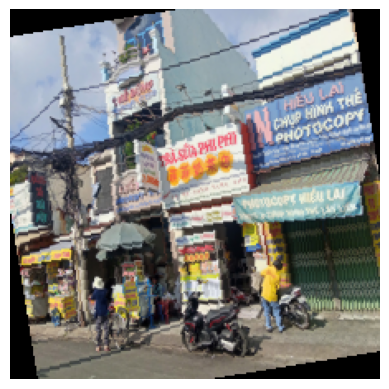

Evaluating:  57%|█████▋    | 57/100 [00:17<00:14,  2.98it/s]

Batch [58/100], Sample [1/1]
Question: bánh_mì thịt nướng có_giá bao_nhiêu ?
Generated Answer: <s> 18 k </s>
Actual Answer: 18 k
Loss: 0.0005
----------------------------


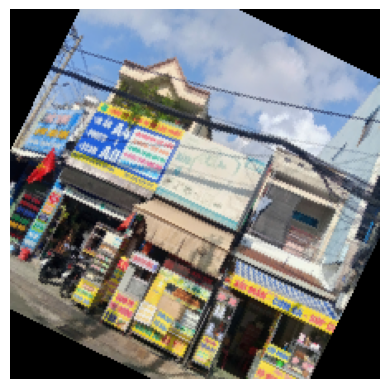

Evaluating:  58%|█████▊    | 58/100 [00:18<00:14,  2.84it/s]

Batch [59/100], Sample [1/1]
Question: cửa_hàng in_ấn lộc phát có địa_chỉ ở đâu ?
Generated Answer: <s> 32 lê@@ _lợi , p . 4 , gò vấp </s>
Actual Answer: 32 lê_lợi , p . 4 , gò vấp
Loss: 0.1024
----------------------------


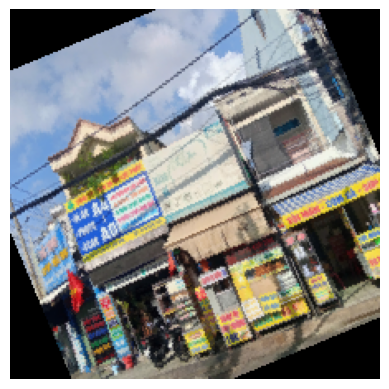

Evaluating:  59%|█████▉    | 59/100 [00:18<00:14,  2.87it/s]

Batch [60/100], Sample [1/1]
Question: cửa_hàng in_ấn lộc phát có số điện_thoại là gì ?
Generated Answer: <s> 0@@ 78 nhật 11@@ 11 </s>
Actual Answer: 078 578 1111
Loss: 1.2300
----------------------------


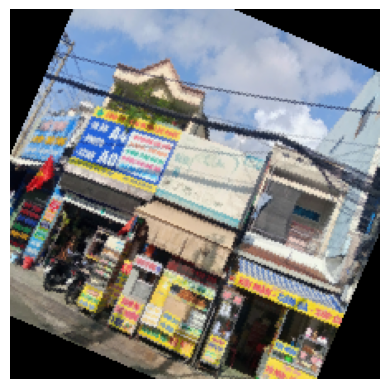

Evaluating:  60%|██████    | 60/100 [00:18<00:13,  2.90it/s]

Batch [61/100], Sample [1/1]
Question: siêu_thị này có tên là gì ?
Generated Answer: <s> cm me@@ ga market </s>
Actual Answer: mm mega market
Loss: 1.4198
----------------------------


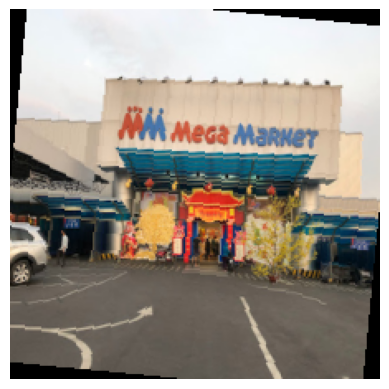

Evaluating:  61%|██████    | 61/100 [00:18<00:12,  3.24it/s]

Batch [62/100], Sample [1/1]
Question: số điện_thoại trên quảng_cáo là gì ?
Generated Answer: <s> 09@@ 11 . 39 . 55@@ 55 </s>
Actual Answer: 0911 . 39 . 5555
Loss: 0.0126
----------------------------


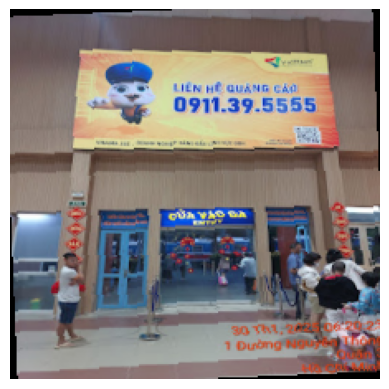

Evaluating:  62%|██████▏   | 62/100 [00:19<00:10,  3.48it/s]

Batch [63/100], Sample [1/1]
Question: trường đại_học này có tên là gì ?
Generated Answer: <s> kinh_tế - phòng t@@ p . h@@ cm </s>
Actual Answer: kinh_tế - tài_chính tp . hcm
Loss: 0.5459
----------------------------


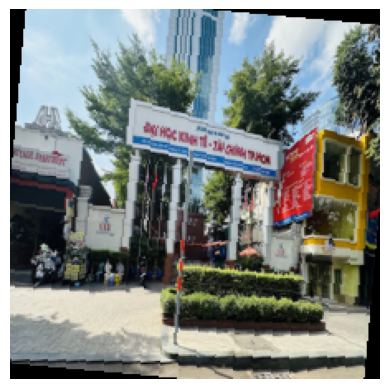

Evaluating:  63%|██████▎   | 63/100 [00:19<00:10,  3.62it/s]

Batch [64/100], Sample [1/1]
Question: ngoài sửa_chữa laptop thì ở đây còn kinh_doanh gì ?
Generated Answer: <s> điện_thoại ép kính </s>
Actual Answer: điện_thoại ép kính
Loss: 0.0153
----------------------------


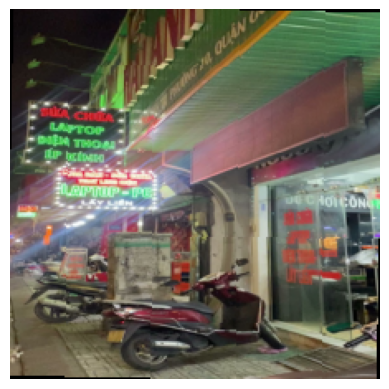

Evaluating:  64%|██████▍   | 64/100 [00:19<00:09,  3.72it/s]

Batch [65/100], Sample [1/1]
Question: quán ăn này có địa_chỉ ở đâu ?
Generated Answer: <s> 58 lê@@ _lợi , p@@ 4 , q . gò vấp , t@@ p . h@@ cm </s>
Actual Answer: 58 lê_lợi , p4 , q . gò vấp , tp . hcm
Loss: 0.0694
----------------------------


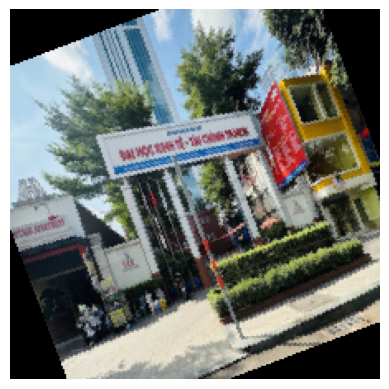

Evaluating:  65%|██████▌   | 65/100 [00:19<00:09,  3.64it/s]

Batch [66/100], Sample [1/1]
Question: quán ăn này có số điện_thoại là gì ?
Generated Answer: <s> 09@@ 24 467 ner </s>
Actual Answer: 0924 467 855
Loss: 1.4992
----------------------------


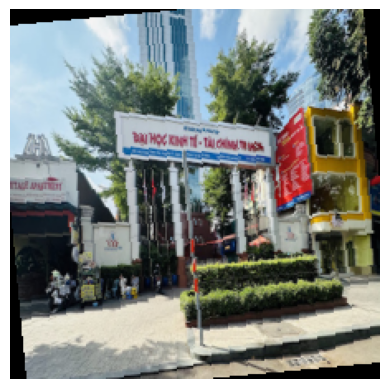

Evaluating:  66%|██████▌   | 66/100 [00:20<00:09,  3.59it/s]

Batch [67/100], Sample [1/1]
Question: tên của cửa tiệm trong ảnh là gì ?
Generated Answer: <s> y@@ ãi y@@ ãi </s>
Actual Answer: yoshi yoshi
Loss: 2.7321
----------------------------


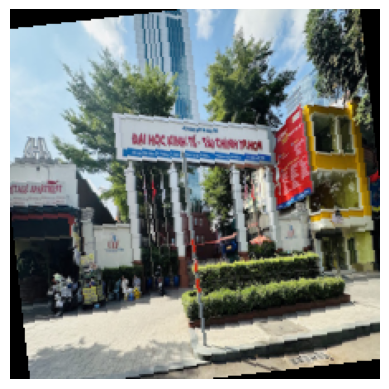

Evaluating:  67%|██████▋   | 67/100 [00:20<00:09,  3.56it/s]

Batch [68/100], Sample [1/1]
Question: ở đây kinh_doanh cái gì ?
Generated Answer: <s> co@@ ffee & tea </s>
Actual Answer: coffee & tea
Loss: 0.0110
----------------------------


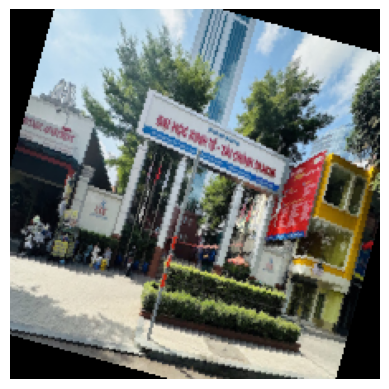

Evaluating:  68%|██████▊   | 68/100 [00:20<00:09,  3.54it/s]

Batch [69/100], Sample [1/1]
Question: địa_chỉ cửa tiệm ở đâu ?
Generated Answer: <s> 48 quang trung_@@ gò vấp </s>
Actual Answer: 48 quang trung_gò vấp
Loss: 0.0480
----------------------------


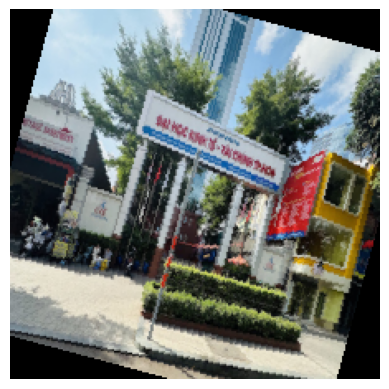

Evaluating:  69%|██████▉   | 69/100 [00:21<00:08,  3.54it/s]

Batch [70/100], Sample [1/1]
Question: thời_gian hoạt_động của cửa_hàng là gì ?
Generated Answer: <s> 24 / 7 </s>
Actual Answer: 24 / 7
Loss: 0.0003
----------------------------


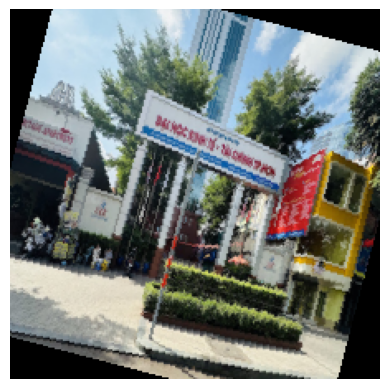

Evaluating:  70%|███████   | 70/100 [00:21<00:08,  3.52it/s]

Batch [71/100], Sample [1/1]
Question: nhà_hàng này có địa_chỉ ở đâu ?
Generated Answer: <s> 66 qua@@ ng_tr@@ ung , p . 10 , gò vấp </s>
Actual Answer: 144 quang_trung , p . 10 , gò vấp
Loss: 0.7343
----------------------------


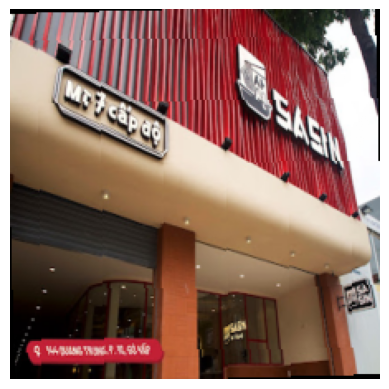

Evaluating:  71%|███████   | 71/100 [00:21<00:08,  3.42it/s]

Batch [72/100], Sample [1/1]
Question: nhà_hàng này kinh_doanh món gì ?
Generated Answer: <s> mì 7 cấp_độ </s>
Actual Answer: mì 7 cấp_độ
Loss: 0.6699
----------------------------


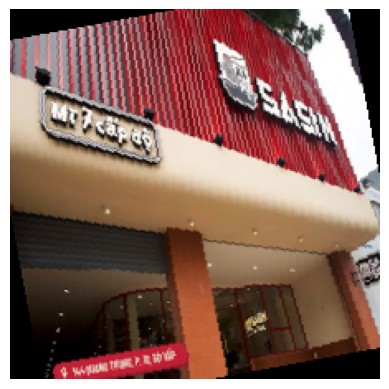

Evaluating:  72%|███████▏  | 72/100 [00:22<00:08,  3.46it/s]

Batch [73/100], Sample [1/1]
Question: nhà_hàng này có tên là gì ?
Generated Answer: <s> s@@ as@@ in </s>
Actual Answer: sasin
Loss: 0.0060
----------------------------


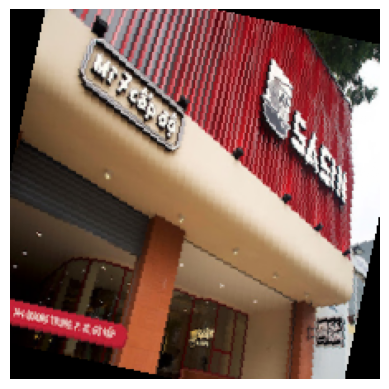

Evaluating:  73%|███████▎  | 73/100 [00:22<00:07,  3.48it/s]

Batch [74/100], Sample [1/1]
Question: cửa tiệm này có tên là gì ?
Generated Answer: <s> mo@@ bi@@ fone </s>
Actual Answer: mobifone
Loss: 1.0400
----------------------------


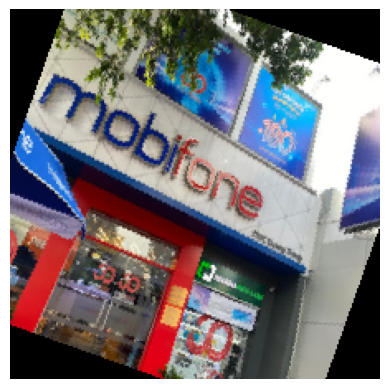

Evaluating:  74%|███████▍  | 74/100 [00:22<00:07,  3.50it/s]

Batch [75/100], Sample [1/1]
Question: cửa tiệm này có tên là gì ?
Generated Answer: <s> dũng </s>
Actual Answer: dũng
Loss: 0.3377
----------------------------


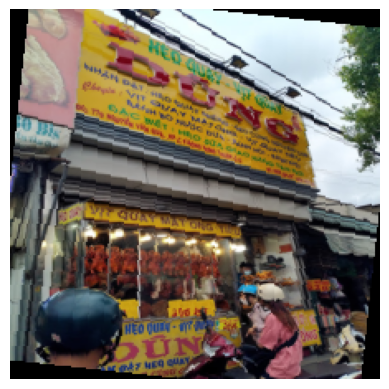

Evaluating:  75%|███████▌  | 75/100 [00:22<00:07,  3.46it/s]

Batch [76/100], Sample [1/1]
Question: cửa tiệm trong bức_hình có_điều gì đặc_biệt ?
Generated Answer: <s> heo sữa giao hàng tận nơi </s>
Actual Answer: heo sữa giao hàng tận nơi
Loss: 0.0647
----------------------------


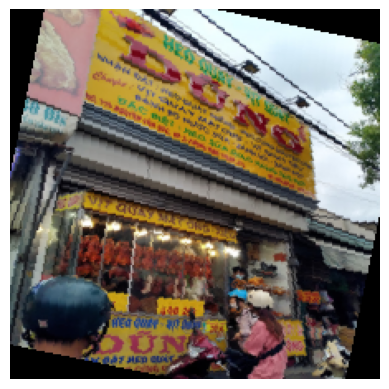

Evaluating:  76%|███████▌  | 76/100 [00:23<00:06,  3.48it/s]

Batch [77/100], Sample [1/1]
Question: cửa tiệm này có tên là gì ?
Generated Answer: <s> to@@ yo@@ ta an_@@ sương </s>
Actual Answer: toyota an_sương
Loss: 1.1011
----------------------------


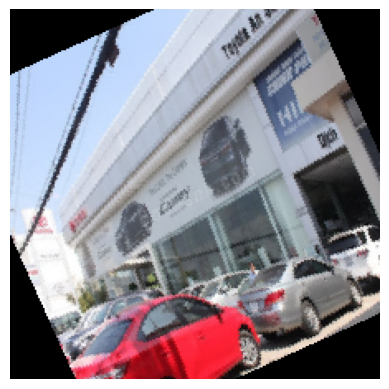

Evaluating:  77%|███████▋  | 77/100 [00:23<00:06,  3.49it/s]

Batch [78/100], Sample [1/1]
Question: đây là văn_phòng gì ?
Generated Answer: <s> công_chứng </s>
Actual Answer: công_chứng
Loss: 2.0500
----------------------------


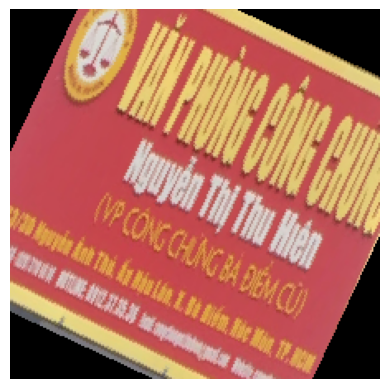

Evaluating:  78%|███████▊  | 78/100 [00:23<00:06,  3.50it/s]

Batch [79/100], Sample [1/1]
Question: tên của văn_phòng này là gì ?
Generated Answer: <s> nguy@@ ễ@@ n_thị thu hiện </s>
Actual Answer: nguyễn_thị thu hiên
Loss: 1.6650
----------------------------


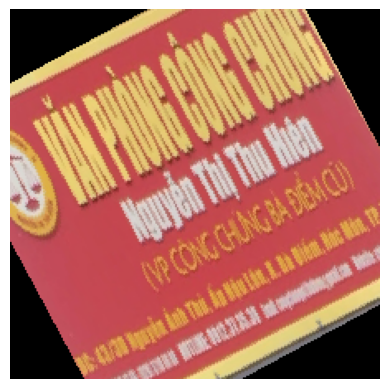

Evaluating:  79%|███████▉  | 79/100 [00:23<00:05,  3.56it/s]

Batch [80/100], Sample [1/1]
Question: địa_chỉ của văn_phòng ở đâu ?
Generated Answer: <s> 43 / 3 d nguy@@ ễn_@@ á@@ <unk> , ấp hò@@ u_l@@ ân , x . bà điểm , hóc_@@ môn , t@@ p . h@@ cm </s>
Actual Answer: 43 / 3 d nguyễn_ánh_thủ , ấp hậu_lân , x . bà điểm , hóc_môn , tp . hcm
Loss: 0.9992
----------------------------


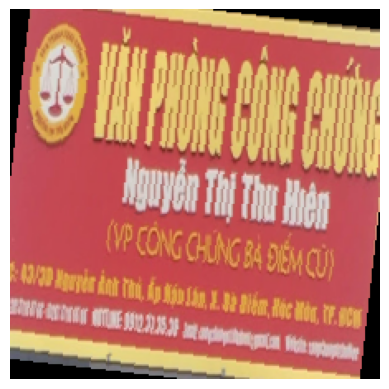

Evaluating:  80%|████████  | 80/100 [00:24<00:05,  3.57it/s]

Batch [81/100], Sample [1/1]
Question: số hotline của văn_phòng là gì ?
Generated Answer: <s> 09@@ 12 . 37 . 35 . 36 </s>
Actual Answer: 0912 . 37 . 35 . 36
Loss: 0.0019
----------------------------


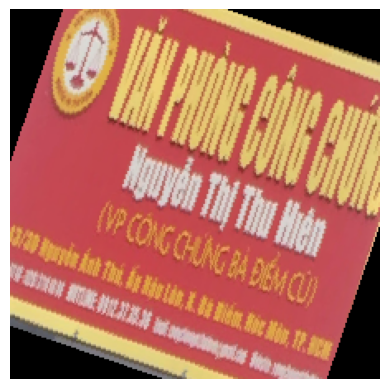

Evaluating:  81%|████████  | 81/100 [00:24<00:05,  3.59it/s]

Batch [82/100], Sample [1/1]
Question: đây là trung_tâm gì ?
Generated Answer: <s> dạy nghề người viet@@ & trẻ sữa t@@ p . h@@ cm </s>
Actual Answer: dạy nghề người khuyết_tật & trẻ mồ_côi tp . hcm
Loss: 1.7357
----------------------------


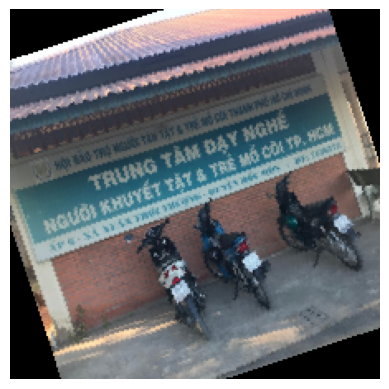

Evaluating:  82%|████████▏ | 82/100 [00:24<00:05,  3.54it/s]

Batch [83/100], Sample [1/1]
Question: tên công_ty này là gì ?
Generated Answer: <s> hai long_@@ an </s>
Actual Answer: hai long_an
Loss: 0.0115
----------------------------


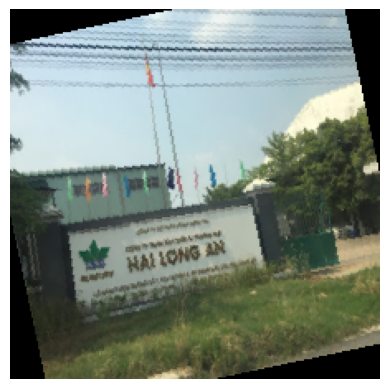

Evaluating:  83%|████████▎ | 83/100 [00:25<00:04,  3.53it/s]

Batch [84/100], Sample [1/1]
Question: nhãn_hiệu của hộp bánh là gì ?
Generated Answer: <s> d@@ q@@ a </s>
Actual Answer: danisa
Loss: 1.3581
----------------------------


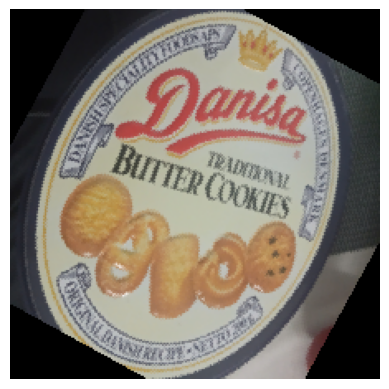

Evaluating:  84%|████████▍ | 84/100 [00:25<00:04,  3.30it/s]

Batch [85/100], Sample [1/1]
Question: hộp bánh này có khối_lượng bao_nhiêu ?
Generated Answer: <s> 200 g </s>
Actual Answer: 200 g
Loss: 0.0042
----------------------------


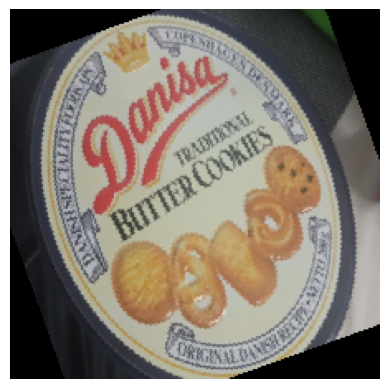

Evaluating:  85%|████████▌ | 85/100 [00:25<00:04,  3.18it/s]

Batch [86/100], Sample [1/1]
Question: thông_tin phân_bố của loài động_vật trên bảng là ở đâu ?
Generated Answer: <s> các nước đông nam_@@ á , b@@ ang@@ tt@@ quang , . . . </s>
Actual Answer: các nước đông nam_á , bangladesh , . . .
Loss: 1.6324
----------------------------


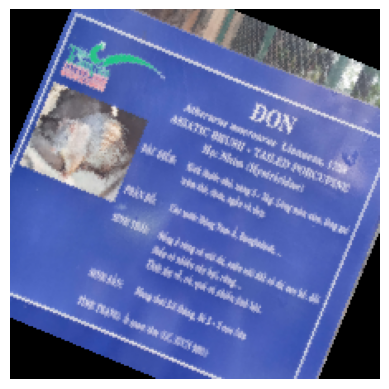

Evaluating:  86%|████████▌ | 86/100 [00:26<00:04,  3.00it/s]

Batch [87/100], Sample [1/1]
Question: thông_tin sinh_sản của loài động_vật trên bảng là gì ?
Generated Answer: <s> mang thay 2 - 3 tháng , chốt 2 - 3 con / 9@@ </s>
Actual Answer: mang thay 2 - 3 tháng , đẻ 2 - 3 con / lứa
Loss: 1.6715
----------------------------


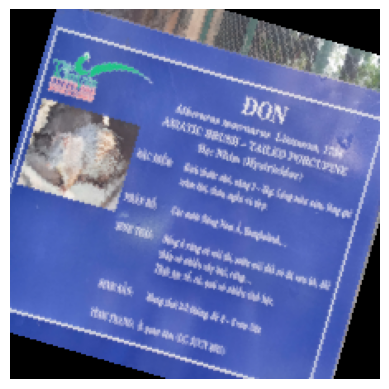

Evaluating:  87%|████████▋ | 87/100 [00:26<00:04,  2.96it/s]

Batch [88/100], Sample [1/1]
Question: tình_trạng của loài động_vật trên bảng là gì ?
Generated Answer: <s> ít quan_tâm ( l@@ c , i@@ nai n 2021 ) </s>
Actual Answer: ít quan_tâm ( lc , iucn 2021 )
Loss: 1.0751
----------------------------


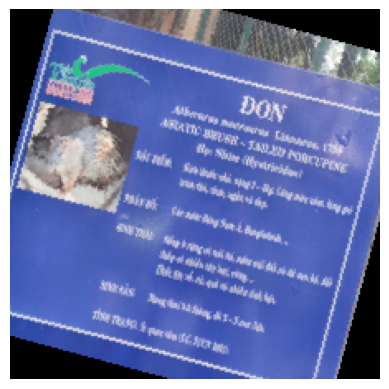

Evaluating:  88%|████████▊ | 88/100 [00:26<00:04,  2.87it/s]

Batch [89/100], Sample [1/1]
Question: họ của loài động_vật trên bảng là gì ?
Generated Answer: <s> quang ( đồng_@@ tr@@ ó@@ ) </s>
Actual Answer: nhím ( hystricidae )
Loss: 6.5222
----------------------------


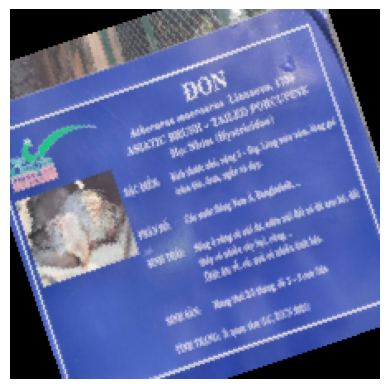

Evaluating:  89%|████████▉ | 89/100 [00:27<00:03,  2.91it/s]

Batch [90/100], Sample [1/1]
Question: dặc điểm của loài động_vật trên bảng là gì ?
Generated Answer: <s> to nhỏ , 61 3 - 5 kg . lông màu cá , que gai tr@@ 78 ô , kh@@ , cổ_phần và chuyện . </s>
Actual Answer: kích_thước nhỏ , nặng 3 - 5 kg . lông màu xám , lông_gai trâm_thô , thưa , ngắn và dẹp .
Loss: 3.3080
----------------------------


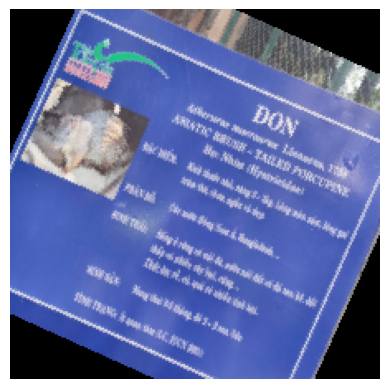

Evaluating:  90%|█████████ | 90/100 [00:27<00:03,  2.93it/s]

Batch [91/100], Sample [1/1]
Question: thông_tin phân_bố của loài động_vật trên bảng là ở đâu ?
Generated Answer: <s> trung và nam_@@ mỹ . </s>
Actual Answer: trung và nam_mỹ .
Loss: 0.0337
----------------------------


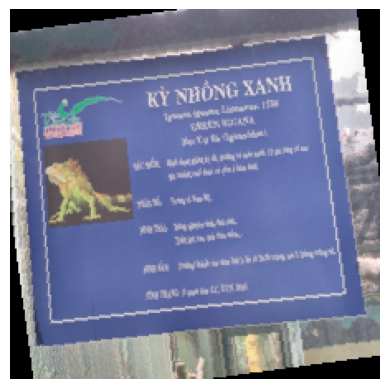

Evaluating:  91%|█████████ | 91/100 [00:27<00:03,  2.89it/s]

Batch [92/100], Sample [1/1]
Question: thông_tin sinh_sản của loài động_vật trên bảng là gì ?
Generated Answer: <s> trưởng_thành vào năm thứ 3 , chốt từ 20 - 30 trứng , sau 3 tháng trứng 62 . </s>
Actual Answer: trưởng_thành vào năm thứ 3 , đẻ từ 20 - 30 trứng , sau 3 tháng trứng nở .
Loss: 1.1622
----------------------------


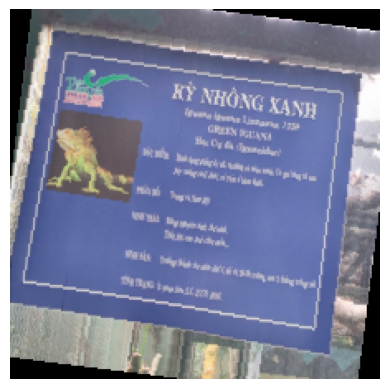

Evaluating:  92%|█████████▏| 92/100 [00:28<00:02,  2.91it/s]

Batch [93/100], Sample [1/1]
Question: tình_trạng của loài động_vật trên bảng là gì ?
Generated Answer: <s> ít quan_tâm ( l@@ c , i@@ nai n 2016 ) . </s>
Actual Answer: ít quan_tâm ( lc , iucn 2016 ) .
Loss: 1.0160
----------------------------


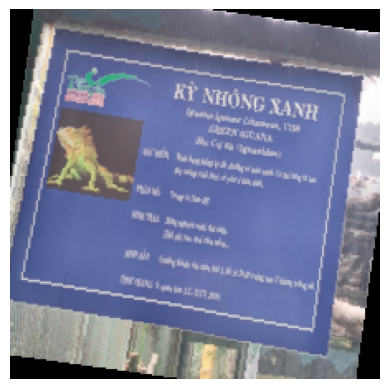

Evaluating:  93%|█████████▎| 93/100 [00:28<00:02,  2.93it/s]

Batch [94/100], Sample [1/1]
Question: họ của loài động_vật trên bảng là gì ?
Generated Answer: <s> thái_@@ đà ( gỗ an@@ phat ) </s>
Actual Answer: cự đà ( iguanidae )
Loss: 4.0901
----------------------------


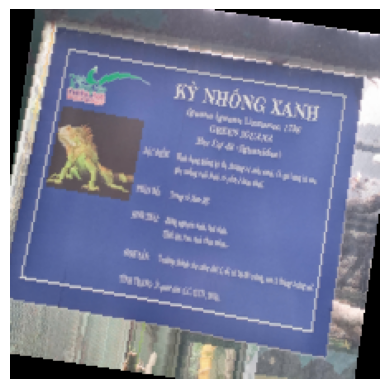

Evaluating:  94%|█████████▍| 94/100 [00:28<00:02,  2.95it/s]

Batch [95/100], Sample [1/1]
Question: thức_ăn của loài động_vật trên bảng là gì ?
Generated Answer: <s> rau , quả chín mềm . . . </s>
Actual Answer: rau , quả chín mềm . . .
Loss: 0.6363
----------------------------


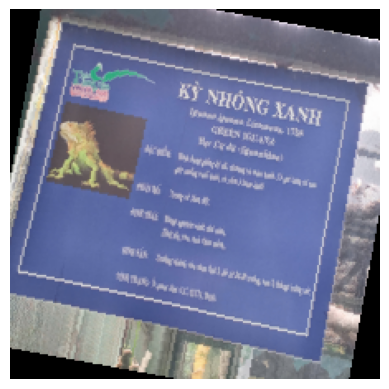

Evaluating:  95%|█████████▌| 95/100 [00:29<00:01,  2.94it/s]

Batch [96/100], Sample [1/1]
Question: dặc điểm của loài động_vật trên bảng là gì ?
Generated Answer: <s> theo 76 99 , thường có màu xanh . có 03 xuân từ sau huyện xuống cuối đuôi , có 62 ở hàm dưới . </s>
Actual Answer: hình_dạng giống kỳ_đà , thường có màu xanh . có gai_lưng từ sau gáy xuống cuối đuôi , có yếm ở hàm dưới .
Loss: 3.7017
----------------------------


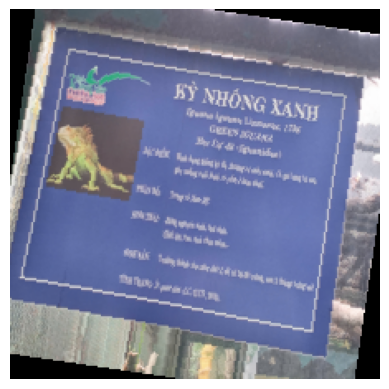

Evaluating:  96%|█████████▌| 96/100 [00:29<00:01,  2.95it/s]

Batch [97/100], Sample [1/1]
Question: đây là hội_nghị gì ?
Generated Answer: <s> khoa_học cấp khoa </s>
Actual Answer: khoa_học cấp khoa
Loss: 0.5301
----------------------------


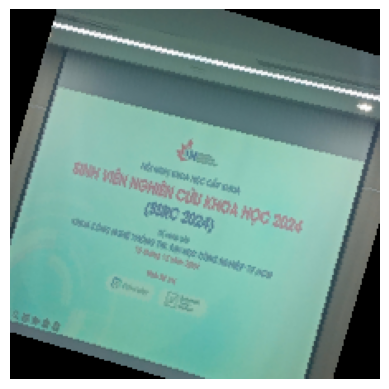

Evaluating:  97%|█████████▋| 97/100 [00:29<00:01,  2.96it/s]

Batch [98/100], Sample [1/1]
Question: hội_nghị này tổ_chức ai ?
Generated Answer: <s> khoa công_nghệ , đại_học công_nghiệp t@@ p . h@@ cm </s>
Actual Answer: khoa công_nghệ_thông_tin , đại_học công_nghiệp tp . hcm
Loss: 0.6350
----------------------------


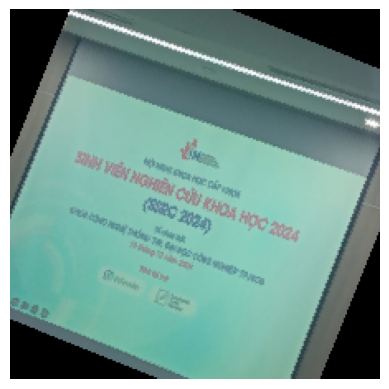

Evaluating:  98%|█████████▊| 98/100 [00:30<00:00,  3.01it/s]

Batch [99/100], Sample [1/1]
Question: hội_nghị này tổ_chức vào thời_gian nào ?
Generated Answer: <s> 15 tháng 12 năm 2023 </s>
Actual Answer: 15 tháng 12 năm 2024
Loss: 2.1115
----------------------------


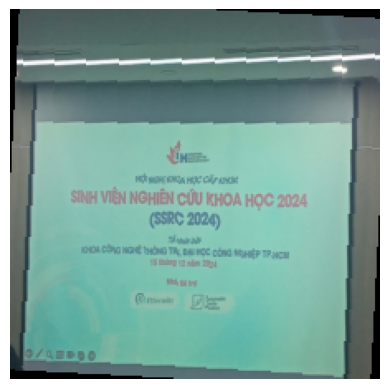

Evaluating:  99%|█████████▉| 99/100 [00:30<00:00,  3.19it/s]

Batch [100/100], Sample [1/1]
Question: hội_nghị này được tài_trợ bởi tổ_chức nào ?
Generated Answer: <s> f@@ 1@@ se@@ amil@@ ty su@@ s@@ mỹ_phẩm no@@ nội_thất ti@@ le so@@ lu@@ tion </s>
Actual Answer: f1security sustainable textile solutions
Loss: 3.3578
----------------------------


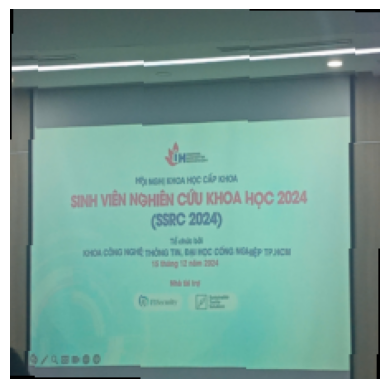

Evaluating: 100%|██████████| 100/100 [00:30<00:00,  3.24it/s]

Average Test Loss: 1.0571


In [41]:
test_losses, avg_loss = evaluate(model, test_loader, criterion, vocab_swap, device, print_every=1, max_len=MAX_LEN)